#Class 3: Getting Started with Text Generation LLM APIs

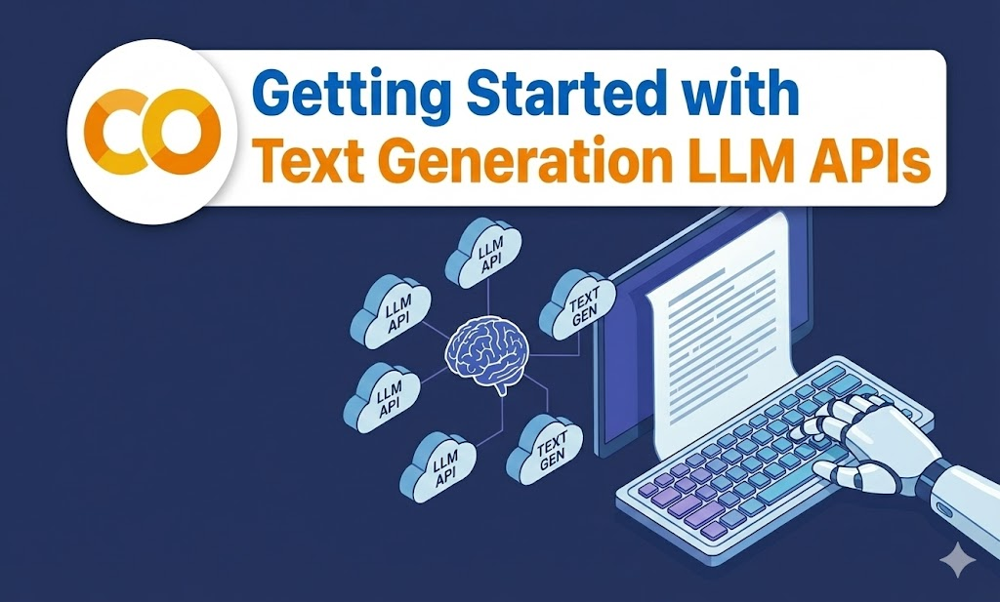

## Summary: Text Generation LLM APIs

### Overview

This comprehensive tutorial provides hands-on mastery of modern LLM APIs for text generation. You'll learn:

- **Model Types**  
  Alos Models which can generate and models which can reason.
  The critical differences between base, instruct, and chat models

- **Chat Templates**  
  Detailed formats for Llama 3.x, DeepSeek, Qwen, Phi, Gemma, and Mistral

- **Decoding Strategies**  
  How LLMs generate text using greedy search, beam search, top-k sampling, and nucleus (top-p) sampling

- **OpenAI API**  
  Chat completions, streaming responses, structured outputs, and function calling

- **Anthropic Claude API**  
  Key differences in API design and usage patterns

- **Hugging Face**  
  Both cloud-based inference and local model execution

- **Ollama**  
  Local LLM serving with an overview of its architecture

- **Production Patterns**  
  Error handling, retries, observability, and cost tracking




### References
- [Decoding Strategies](https://huggingface.co/blog/mlabonne/decoding-strategies)

By the end, you'll be able to build **production-ready LLM applications** with proper control over generation behavior.
---


##Key Steps Covered


###1. Environment Setup


* Required packages are installed for all three providers.
* API keys are configured via environment variables.
* Clients are initialized for OpenAI, Anthropic, and HuggingFace.

In [13]:
!pip install openai anthropic huggingface_hub transformers accelerate pydantic tenacity torch -q

In [1]:
import os
import getpass

In [2]:
# Configure API keys from Colab Secrets
os.environ["OPENAI_API_KEY"] = getpass.getpass('OPENAI_API_KEY')

OPENAI_API_KEY··········


In [3]:
#os.environ["ANTHROPIC_API_KEY"] = getpass.getpass('ANTHROPIC_API_KEY')


In [12]:
from huggingface_hub import login
login()

In [5]:
# Initialize clients
from openai import OpenAI
#import anthropic

openai_client = OpenAI()  # Reads OPENAI_API_KEY automatically
#anthropic_client = anthropic.Anthropic()  # Reads ANTHROPIC_API_KEY automatically

print("✅ Clients initialized successfully!")

✅ Clients initialized successfully!


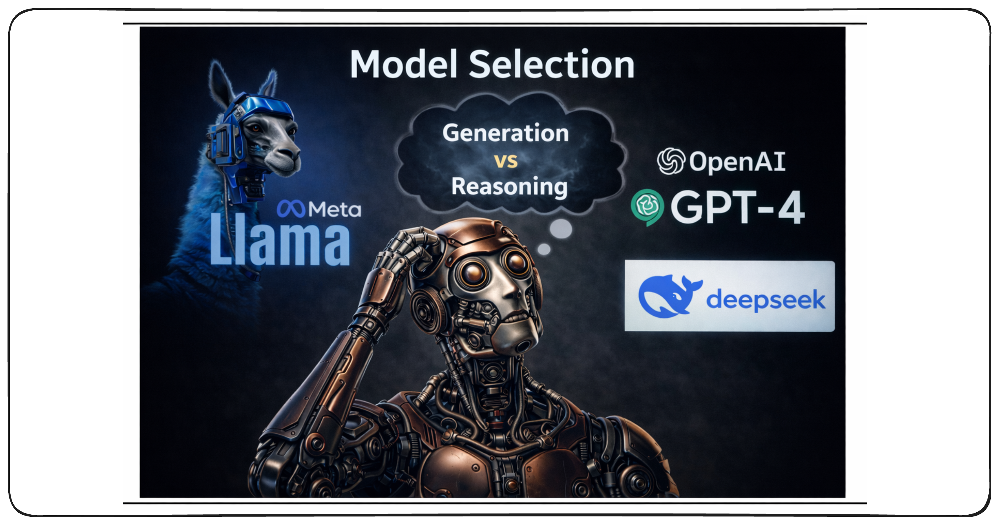

## Generation Models vs Reasoning Models

### Selecting the Right Model Architecture for Your Use Case

Model selection often fails because teams pick based on benchmark rankings rather than task requirements. A top-performing model on MMLU might be entirely unsuitable for your specific application.

**Core principle:** Match the model's cognitive architecture to your problem's demands, not its position on a leaderboard.

---

### Start with Task Analysis, Not Model Specs

Before comparing models, decompose your task into its fundamental requirements.

**Ask:** What type of cognitive work does this application demand?

Consider two contrasting scenarios from financial services:

**Scenario 1:** Draft personalized investment summaries from portfolio data  
**Scenario 2:** Validate tax optimization strategies across multiple jurisdictions

Both involve finance and text, but demand entirely different capabilities:
- First scenario: Language fluency + structured formatting
- Second scenario: Multi-hop logical verification + constraint satisfaction

---

### Two Architectural Paradigms

Modern LLMs fall into two distinct architectural families based on their optimization target.

---

### Generation-Optimized Architecture

Models: **GPT-4o**, **GPT-4o-mini**, **Claude Sonnet 4**, **Gemini 1.5 Flash**

**Design goal:** Maximize language fluency and contextual coherence

**Strengths:**
- Natural, human-like text production
- Rapid response generation
- Cost-effective for high-volume applications
- Strong performance on open-ended creative tasks

**Ideal applications:**
- Customer support chatbots
- Content summarization and rewriting
- Email drafting and tone adjustment
- Marketing copy generation

---

### Reasoning-Optimized Architecture

Models: **o1**, **o1-mini**, **o3-mini**, **Claude Opus**, **Gemini 2.5 Pro**, **DeepSeek R1**

**Design goal:** Solve complex problems through internal step-by-step decomposition

**Key mechanism:** Built-in chain-of-thought processing that breaks problems into verifiable sub-steps

**Strengths:**
- Handles multi-step inference chains
- Self-corrects logical errors during generation
- Reliable on problems requiring mathematical precision
- Better at edge case discovery

**Ideal applications:**
- Code generation with complex requirements
- Mathematical problem solving
- Legal/medical document analysis
- Strategic planning tasks

---

### The Prompting Burden Trade-off

Generation models can perform logical tasks, but require extensive prompt engineering to scaffold the reasoning process.

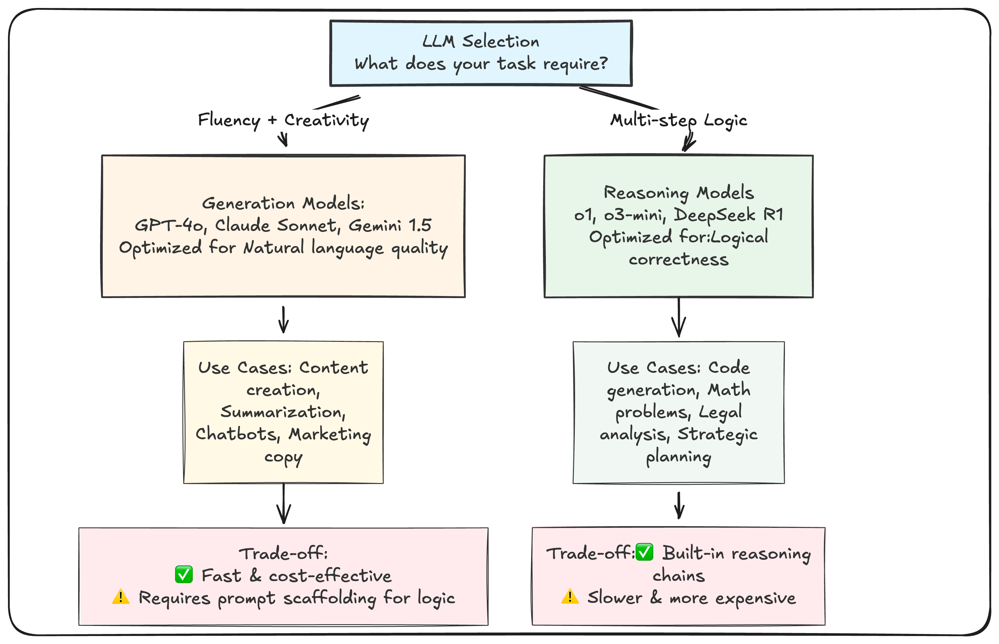

In [6]:
# Demonstration: Loan approval decision with different architectures

from openai import OpenAI
client = OpenAI()

def loan_decision_with_generation_model(applicant_data):
    """
    Using GPT-4o-mini (generation architecture)
    Requires explicit decomposition of the decision process
    """

    structured_prompt = f"""
You are evaluating a loan application. Follow these exact steps:

STEP 1 - Compute debt-to-income ratio:
Monthly debt: ${applicant_data['debt']}
Monthly income: ${applicant_data['income']}
Formula: debt ÷ income
Your calculation: _____

STEP 2 - Classify credit tier:
Score: {applicant_data['credit_score']}
Tiers:
  740+: Premium
  670-739: Standard
  580-669: Subprime
  <580: High-risk
Classification: _____

STEP 3 - Verify employment:
Months employed: {applicant_data['employment_months']}
Minimum required: 24 months
Income stability (variance): {applicant_data['income_variance']}%
Maximum allowed: 15%
Status: _____

STEP 4 - Assess collateral:
Property value: ${applicant_data['collateral']}
Loan amount: ${applicant_data['loan_amount']}
LTV ratio: _____

[... would continue for all decision criteria ...]

FINAL OUTPUT: Approved/Denied with justification
"""

    response = client.chat.completions.create(
        model="gpt-4o-mini",
        messages=[{"role": "user", "content": structured_prompt}],
        temperature=0
    )

    return response.choices[0].message.content


def loan_decision_with_reasoning_model(applicant_data):
    """
    Using o1-mini (reasoning architecture)
    Model performs internal decomposition automatically
    """

    minimal_prompt = f"""
Evaluate this loan application against our criteria:

Applicant Data:
- Monthly debt: ${applicant_data['debt']}
- Monthly income: ${applicant_data['income']}
- Credit score: {applicant_data['credit_score']}
- Employment: {applicant_data['employment_months']} months
- Income variance: {applicant_data['income_variance']}%
- Collateral value: ${applicant_data['collateral']}
- Requested amount: ${applicant_data['loan_amount']}

Approval Criteria:
- Debt-to-income < 43%
- Credit score ≥ 580
- Employment ≥ 24 months with income variance < 15%
- Adequate collateral coverage

Decision: Approve or deny? Explain your reasoning.
"""

    response = client.chat.completions.create(
        model="o1",
        messages=[{"role": "user", "content": minimal_prompt}]
    )

    return response.choices[0].message.content


# Example applicant
test_application = {
    'debt': 2800,
    'income': 7500,
    'credit_score': 695,
    'employment_months': 30,
    'income_variance': 12.5,
    'collateral': 180000,
    'loan_amount': 140000
}

print("="*70)
print("GENERATION MODEL (GPT-4o-mini)")
print("="*70)
print("Prompt strategy: Explicit step-by-step scaffolding")
print("Engineer's role: Design the reasoning chain")
print("Token cost: Lower per call")
print()

print("="*70)
print("REASONING MODEL (o1-mini)")
print("="*70)
print("Prompt strategy: State goal + constraints")
print("Engineer's role: Define success criteria")
print("Token cost: Higher per call, but more reliable logic")
print("="*70)

GENERATION MODEL (GPT-4o-mini)
Prompt strategy: Explicit step-by-step scaffolding
Engineer's role: Design the reasoning chain
Token cost: Lower per call

REASONING MODEL (o1-mini)
Prompt strategy: State goal + constraints
Engineer's role: Define success criteria
Token cost: Higher per call, but more reliable logic


In [7]:
# Uncomment to run actual comparison
print("\n" + "="*70)
print("GPT-4o-mini RESPONSE:")
print("="*70)
result_gen = loan_decision_with_generation_model(test_application)
print(result_gen)
print()




GPT-4o-mini RESPONSE:
### STEP 1 - Compute debt-to-income ratio:
Monthly debt: $2800  
Monthly income: $7500  
Formula: debt ÷ income  
Your calculation: \( \frac{2800}{7500} = 0.3733 \) or 37.33%

### STEP 2 - Classify credit tier:
Score: 695  
Tiers:
- 740+: Premium
- 670-739: Standard
- 580-669: Subprime
- <580: High-risk  
Classification: Standard

### STEP 3 - Verify employment:
Months employed: 30  
Minimum required: 24 months  
Income stability (variance): 12.5%  
Maximum allowed: 15%  
Status: Verified (meets minimum employment requirement and variance is acceptable)

### STEP 4 - Assess collateral:
Property value: $180,000  
Loan amount: $140,000  
LTV ratio: \( \frac{140000}{180000} = 0.7778 \) or 77.78%

### FINAL OUTPUT:
**Approved**  
Justification: The applicant has a debt-to-income ratio of 37.33%, which is within acceptable limits. The credit score of 695 classifies them as Standard, indicating a reasonable credit risk. Employment verification shows stability with 30 m

In [14]:
print("="*70)
print("o1 RESPONSE:")
print("="*70)
result_reason = loan_decision_with_reasoning_model(test_application)
print(result_reason)

o1-mini RESPONSE:
Decision: Approve.

Reasoning:

1. Debt-to-Income (DTI) Ratio: The applicant’s monthly debt ($2,800) compared to income ($7,500) yields a DTI of approximately 37.3%, which is below the 43% threshold.

2. Credit Score: At 695, the applicant’s credit score exceeds the 580 minimum requirement.

3. Employment and Income Variance: With 30 months of employment (above the 24‐month requirement) and an income variance of 12.5% (under the 15% limit), both criteria are met.

4. Collateral Coverage: The requested amount ($140,000) is less than the collateral value ($180,000), indicating sufficient coverage.

Because the applicant meets or exceeds all listed criteria, the loan application would be approved.


# Part 2: Understanding Model Types

### 2. Base vs Instruct vs Chat Models

- Not all LLMs behave the same way—their training determines their capabilities.
- Understanding these differences is **critical** for choosing the right model.

| Model Type | Training                              | Behavior                                   | Use Case                                   |
|------------|---------------------------------------|---------------------------------------------|--------------------------------------------|
| **Base**   | Next-token prediction on raw text     | Continues text, doesn't follow instructions | Text completion, fine-tuning starting point |
| **Instruct** | Fine-tuned on instruction-response pairs | Follows single-turn instructions            | Q&A, summarization, single tasks            |
| **Chat**   | Fine-tuned on multi-turn conversations | Handles dialogue, maintains context         | Chatbots, assistants, conversations        |


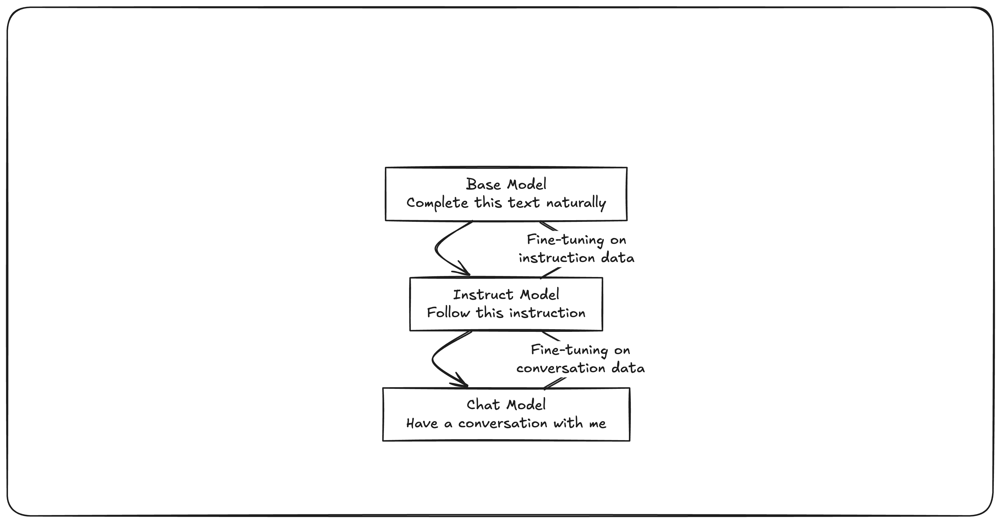

---

### 3. Base Model Behavior

- Base models are trained purely on **next-token prediction**.
- They don't understand "instructions"—they just continue the text.
- Think of them as autocomplete on steroids.


In [14]:
from transformers import AutoModelForCausalLM, AutoTokenizer
import torch

In [15]:
# Load a base model (GPT-2 is a classic example)
model_name = "gpt2"

In [16]:
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModelForCausalLM.from_pretrained(model_name)

In [26]:

# Try giving it an instruction
prompt = "What is the capital of France?"

In [27]:
input_ids = tokenizer.encode(prompt, return_tensors="pt")

In [28]:
input_ids

tensor([[2061,  318,  262, 3139,  286, 4881,   30]])

In [20]:
model

GPT2LMHeadModel(
  (transformer): GPT2Model(
    (wte): Embedding(50257, 768)
    (wpe): Embedding(1024, 768)
    (drop): Dropout(p=0.1, inplace=False)
    (h): ModuleList(
      (0-11): 12 x GPT2Block(
        (ln_1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
        (attn): GPT2Attention(
          (c_attn): Conv1D(nf=2304, nx=768)
          (c_proj): Conv1D(nf=768, nx=768)
          (attn_dropout): Dropout(p=0.1, inplace=False)
          (resid_dropout): Dropout(p=0.1, inplace=False)
        )
        (ln_2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
        (mlp): GPT2MLP(
          (c_fc): Conv1D(nf=3072, nx=768)
          (c_proj): Conv1D(nf=768, nx=3072)
          (act): NewGELUActivation()
          (dropout): Dropout(p=0.1, inplace=False)
        )
      )
    )
    (ln_f): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
  )
  (lm_head): Linear(in_features=768, out_features=50257, bias=False)
)

In [21]:
#57
output = model.generate(
    input_ids,
    max_new_tokens=50, #Max number of new tokens the model can generate other than the prompt tokens
    do_sample=True,#
    temperature=0.7,#
    pad_token_id=tokenizer.eos_token_id #Eos token is considered as pad token
)


The attention mask is not set and cannot be inferred from input because pad token is same as eos token. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.


In [22]:
output

tensor([[ 2061,   318,   262,  3139,   286,  4881,    30,   198,   198,  2215,
           314,   373,   257,  1310,  2933,    11,  4141,   661,   547,   845,
          6613,   286,   262,  1109,   326,   484,  3181,  4881,   656,   262,
          3427,  4479,    13,  4881,   373,   262,   691,  1499,   326,   373,
          1498,   284,   466,   326,    13,   314,   892,   326,   338,  1682,
           257,  1256,   286, 11293,    13,  4881,   550]])

In [16]:
print("Prompt:", prompt)

Prompt: What is the capital of France?


In [23]:
print("Base Model Output:", tokenizer.decode(
    output[0],  #Single Data Prompt Batch
    skip_special_tokens=True))
#Once upon a time

Base Model Output: What is the capital of France?

When I was a little boy, French people were very proud of the fact that they brought France into the European Union. France was the only country that was able to do that. I think that's actually a lot of pride. France had


In [25]:
print("Base Model Output:", tokenizer.decode(
    output[0],  #Single Data Prompt Batch
    skip_special_tokens=False))
#<s> Once upon a time </s> <pad> <pad>

Base Model Output: What is the capital of France?

When I was a little boy, French people were very proud of the fact that they brought France into the European Union. France was the only country that was able to do that. I think that's actually a lot of pride. France had


- **Observation:**  
  The base model doesn't "answer" the question.

- It continues the text as if it's completing a document or article.

- Sometimes it gets lucky and includes the answer, but it's not reliably following instructions.

#### More Examples of Base Model Behavior


In [18]:
prompts = [
    "Translate 'Hello' to French:",
    "Write a poem about the ocean:",
    "Summarize the following: The quick brown fox jumps over the lazy dog.",
    "Answer the following question: What is 2+2?",
]

for prompt in prompts:
    input_ids = tokenizer.encode(prompt, return_tensors="pt")
    output = model.generate(
        input_ids,
        max_new_tokens=30,
        do_sample=True,
        temperature=0.7,
        pad_token_id=tokenizer.eos_token_id
    )
    print(f"Prompt: {prompt}")
    print(f"Output: {tokenizer.decode(output[0], skip_special_tokens=True)}\n")
    print('-'*50)

Prompt: Translate 'Hello' to French:
Output: Translate 'Hello' to French:

Translation: 'Hello' to French: Hello Hello Hello Hello Hello Hello Hello Hello Hello Hello Hello Hello Hello Hello Hello Hello Hello Hello Hello Hello

--------------------------------------------------
Prompt: Write a poem about the ocean:
Output: Write a poem about the ocean:

I've been searching

for you for years

and I've found

the right place

to write

my

--------------------------------------------------
Prompt: Summarize the following: The quick brown fox jumps over the lazy dog.
Output: Summarize the following: The quick brown fox jumps over the lazy dog. The wolf leaps over the dog. The fox jumps over the dog. The dog jumps over the dog. The dog jumps over the dog. The dog

--------------------------------------------------
Prompt: Answer the following question: What is 2+2?
Output: Answer the following question: What is 2+2?

Answer the following question: What is 1+1?


2+2 = 1

1+1 = 2

2

-----

- Base models often:
  - Continue with more examples of the same pattern
  - Repeat the input
  - Generate quiz-like formats instead of direct answers
  - Don't know when to stop

---


### 4. Instruct Model Behavior

- Instruct models are **fine-tuned** on (instruction, response) pairs.
- They understand that a prompt is a request to perform a task.
- They generate appropriate responses rather than continuations.


In [19]:
from transformers import pipeline
import torch

# Load an instruct model
model_name = "TinyLlama/TinyLlama-1.1B-Chat-v1.0"
generator = pipeline(
    "text-generation",
    model=model_name,
    torch_dtype=torch.float16,
    device_map="auto"
)

# Same prompt as before - using instruction format
prompt = "What is the capital of France?"
formatted_prompt = f"<|user|>\n{prompt}</s>\n<|assistant|>\n"

output = generator(
    formatted_prompt,
    max_new_tokens=50,
    do_sample=True,
    temperature=0.7,
)

config.json:   0%|          | 0.00/608 [00:00<?, ?B/s]

`torch_dtype` is deprecated! Use `dtype` instead!


model.safetensors:   0%|          | 0.00/2.20G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/124 [00:00<?, ?B/s]

tokenizer_config.json: 0.00B [00:00, ?B/s]

tokenizer.model:   0%|          | 0.00/500k [00:00<?, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/551 [00:00<?, ?B/s]

Device set to use cuda:0


In [20]:
print("Prompt:", prompt)

Prompt: What is the capital of France?


In [21]:
print("Instruct Model Output:", output[0]['generated_text'].split("<|assistant|>")[-1].strip())

Instruct Model Output: The capital of France is Paris.


- **Observation:**  
  The instruct model directly answers the question!

- It understands the prompt is an instruction, not text to continue.


In [22]:
from transformers import pipeline
import torch

generator = pipeline(
    "text-generation",
    model="TinyLlama/TinyLlama-1.1B-Chat-v1.0",
    torch_dtype=torch.float16,
    device_map="auto" #gpu cpu
)

# Chat models work with message lists (like OpenAI API!)
messages = [
    {"role": "system", "content": "You are a helpful assistant."},
    {"role": "user", "content": "What is the capital of France?"},
]


Device set to use cuda:0


In [23]:
output = generator(messages, max_new_tokens=50)
print("Chat Model Output:", output[0]['generated_text'][-1]['content'])

Chat Model Output: The capital of France is Paris.



---

###5. Chat Model Behavior

* Chat models handle **multi-turn conversations**
 and maintain context.

In [24]:
# Multi-turn conversation demonstration
messages = [
    {"role": "system", "content": "You are a helpful math tutor."},
    {"role": "user", "content": "What is 5 + 3?"},
]

# First turn
output = generator(messages, max_new_tokens=50)
assistant_response = output[0]['generated_text'][-1]['content']
print(f"User: What is 5 + 3?")
print(f"Assistant: {assistant_response}\n")

# Add assistant response to history
messages.append({"role": "assistant", "content": assistant_response})

# Second turn - referring to previous context
messages.append({"role": "user", "content": "Now multiply that result by 2."})
output = generator(messages, max_new_tokens=50)
assistant_response = output[0]['generated_text'][-1]['content']
print(f"User: Now multiply that result by 2.")
print(f"Assistant: {assistant_response}\n")

# Third turn
messages.append({"role": "assistant", "content": assistant_response})
messages.append({"role": "user", "content": "What if I divide that by 4?"})
output = generator(messages, max_new_tokens=50)
assistant_response = output[0]['generated_text'][-1]['content']
print(f"User: What if I divide that by 4?")
print(f"Assistant: {assistant_response}")

User: What is 5 + 3?
Assistant: 5 + 3 = 8

User: Now multiply that result by 2.
Assistant: 5 + 3 x 2 = 15

2 * 15 = 30

30 = 3 + 3

The answer is 6.

User: What if I divide that by 4?
Assistant: Since you want to divide by 4, you need to use the division operator '/'. The result is 6 divided by 4.

5 / 4 = 1.25

5 + 1.25 =


- **Key observation:**  
  The chat model understands "that result" and "that" refer to previous answers!

- Base models would fail at this because they don't understand conversational context.

---


In [25]:
from transformers import AutoModelForCausalLM, AutoTokenizer, pipeline
import torch

# ============================================================
# SETUP: Load all three model types
# ============================================================

# 1. Base Model (GPT-2)
base_tokenizer = AutoTokenizer.from_pretrained("gpt2")
base_model = AutoModelForCausalLM.from_pretrained("gpt2")

# 2. Instruct/Chat Model
chat_pipe = pipeline(
    "text-generation",
    model="TinyLlama/TinyLlama-1.1B-Chat-v1.0",
    torch_dtype=torch.float16,
    device_map="auto"
)

def generate_base(prompt, max_tokens=50):
    """Generate with base model (raw text continuation)"""
    inputs = base_tokenizer.encode(prompt, return_tensors="pt")
    outputs = base_model.generate(
        inputs,
        max_new_tokens=max_tokens,
        do_sample=True,
        temperature=0.7,
        pad_token_id=base_tokenizer.eos_token_id
    )
    full_output = base_tokenizer.decode(outputs[0], skip_special_tokens=True)
    return full_output[len(prompt):].strip()

def generate_instruct(prompt, max_tokens=50):
    """Generate with instruct format"""
    formatted = f"<|user|>\n{prompt}</s>\n<|assistant|>\n"
    output = chat_pipe(formatted, max_new_tokens=max_tokens, do_sample=True, temperature=0.7)
    return output[0]['generated_text'].split("<|assistant|>")[-1].strip()

def generate_chat(messages, max_tokens=50):
    """Generate with chat format"""
    output = chat_pipe(messages, max_new_tokens=max_tokens)
    return output[0]['generated_text'][-1]['content'].strip()

# ============================================================
# TEST: Same prompts, different model types
# ============================================================

test_cases = [
    {"name": "Simple Question", "prompt": "What is the capital of Japan?"},
    {"name": "Instruction", "prompt": "List 3 benefits of exercise."},
    {"name": "Creative Task", "prompt": "Write a short poem about rain."},
    {"name": "Reasoning", "prompt": "If a train travels 60 mph for 2 hours, how far does it go?"},
]

for test in test_cases:
    prompt = test["prompt"]
    print("=" * 70)
    print(f"TEST: {test['name']}")
    print(f"PROMPT: {prompt}")
    print("=" * 70)

    # Base model
    base_output = generate_base(prompt)
    print(f"\n🔵 BASE MODEL (GPT-2):")
    print(f"   {base_output[:150]}...")

    # Instruct model
    instruct_output = generate_instruct(prompt)
    print(f"\n🟢 INSTRUCT MODEL:")
    print(f"   {instruct_output[:150]}")

    # Chat model
    chat_messages = [
        {"role": "system", "content": "You are a helpful assistant."},
        {"role": "user", "content": prompt}
    ]
    chat_output = generate_chat(chat_messages)
    print(f"\n🟣 CHAT MODEL:")
    print(f"   {chat_output[:150]}")
    print("\n")

Device set to use cuda:0


TEST: Simple Question
PROMPT: What is the capital of Japan?

🔵 BASE MODEL (GPT-2):
   The capital of Japan is Shibuya. The capital capital of Japan is Todegawa. The capital capital of Japan is Shokugeki. The capital capital of Japan is ...

🟢 INSTRUCT MODEL:
   The capital of Japan is Tokyo.

🟣 CHAT MODEL:
   The capital of Japan is Tokyo.


TEST: Instruction
PROMPT: List 3 benefits of exercise.

🔵 BASE MODEL (GPT-2):
   1. Exercise strengthens your brain and prevents nerve damage.

2. Exercise makes you feel better, reduces depression, and increases the number of days...

🟢 INSTRUCT MODEL:
   1. Strengthens the muscles: Regular exercise strengthens the muscles in your body, which in turn helps to maintain your overall strength and mobility.

🟣 CHAT MODEL:
   1. Improved Mental Health: Regular exercise has been shown to improve mental health by reducing stress, anxiety, and depression.

2. Enhanced Physical


TEST: Creative Task
PROMPT: Write a short poem about rain.

🔵 BASE MODEL (GPT

---

### 7. Key Differences Summary

| Aspect | Base Model | Instruct Model | Chat Model |
|------|------------|----------------|------------|
| **Training** | Next-token prediction | Instruction fine-tuning | Conversation fine-tuning |
| **Input Format** | Raw text | Instruction template | Message list with roles |
| **Output** | Text continuation | Task completion | Conversational response |
| **Multi-turn** | ❌ No context awareness | ⚠️ Limited | ✅ Full context |
| **System Prompt** | ❌ Not understood | ⚠️ Sometimes | ✅ Fully supported |
| **When to Use** | Fine-tuning base | Single-turn tasks | Assistants, chatbots |

---



###8. Choosing the Right Model Type

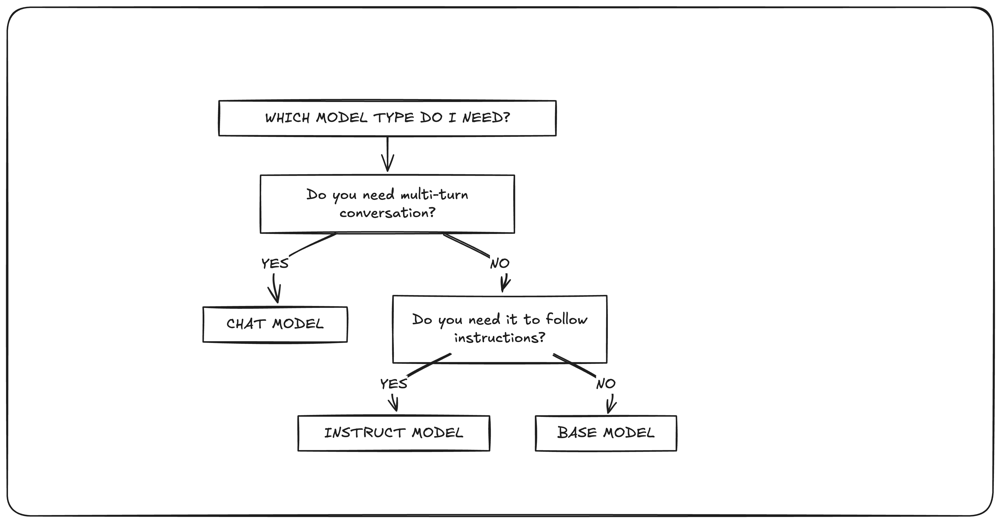

| Use Case | Recommended | Why |
|----------|-------------|-----|
| Customer support chatbot | Chat | Multi-turn, context-aware |
| Code completion | Instruct or Base | Single-turn, pattern completion |
| Document summarization | Instruct | Single-turn task |
| Creative writing assistant | Chat | Interactive, iterative |
| Text classification | Base (fine-tuned) | Custom task |
| Translation | Instruct | Clear instruction |

---


# Part 3: Chat Templates – Comprehensive Guide

### 9. Why Chat Templates Matter

- Each model family uses **different special tokens** to structure conversations.
- Using the wrong template can result in **degraded performance or gibberish output**.
- Hugging Face provides `apply_chat_template()` to handle chat formatting automatically and safely.


In [29]:
from transformers import AutoTokenizer

tokenizer = AutoTokenizer.from_pretrained("meta-llama/Llama-3.1-8B-Instruct")

messages = [
    {
        "role": "system",
        "content": "You are helpful AI Math Tutor." #You are helpgul Math Tutor
    },
    {
        "role": "user",
        "content": "What is 2+3!" #What is 2+3
    }
]

# Automatically formats for the specific model
formatted = tokenizer.apply_chat_template(
    messages,
    tokenize=False,
    add_generation_prompt=True
)

In [30]:
formatted

'<|begin_of_text|><|start_header_id|>system<|end_header_id|>\n\nCutting Knowledge Date: December 2023\nToday Date: 26 Jul 2024\n\nYou are helpful AI Math Tutor.<|eot_id|><|start_header_id|>user<|end_header_id|>\n\nWhat is 2+3!<|eot_id|><|start_header_id|>assistant<|end_header_id|>\n\n'

In [9]:
formatted

'<|begin_of_text|><|start_header_id|>system<|end_header_id|>\n\nCutting Knowledge Date: December 2023\nToday Date: 26 Jul 2024\n\nYou are helpful.<|eot_id|><|start_header_id|>user<|end_header_id|>\n\nHello!<|eot_id|><|start_header_id|>assistant<|end_header_id|>\n\n'

```python
from transformers import AutoTokenizer

tokenizer = AutoTokenizer.from_pretrained("model-name")

messages = [
    {
        "role": "system",
        "content": "You are helpful."
    },
    {
        "role": "user",
        "content": "Hello!"
    }
]

# Automatically formats for the specific model
formatted = tokenizer.apply_chat_template(
    messages,
    tokenize=False,
    add_generation_prompt=True
)


### 7. Llama 3.x Chat Template (3.1, 3.2, 3.3)

- **Models:**  
  `meta-llama/Llama-3.1-8B-Instruct`,  
  `meta-llama/Llama-3.2-3B-Instruct`,  
  `meta-llama/Llama-3.3-70B-Instruct`

- **Special Tokens:**
  - `<|begin_of_text|>` — Beginning of sequence (BOS)
  - `<|end_of_text|>` — End of sequence (EOS)
  - `<|start_header_id|>` — Start of role header
  - `<|end_header_id|>` — End of role header
  - `<|eot_id|>` — End of turn
  - `<|eom_id|>` — End of message (used for tool calls)

- **Roles:**  
  `system`, `user`, `assistant`, `ipython` (for tool results)

#### Template Format

```text
<|begin_of_text|><|start_header_id|>system<|end_header_id|>
Cutting Knowledge Date: December 2023
Today Date: {current_date}
{system_message}<|eot_id|>

<|start_header_id|>user<|end_header_id|>
{user_message}<|eot_id|>

<|start_header_id|>assistant<|end_header_id|>
{assistant_response}<|eot_id|>


**Code Example**

```from transformers import AutoTokenizer

tokenizer = AutoTokenizer.from_pretrained("meta-llama/Llama-3.1-8B-Instruct")

messages = [
    {"role": "system", "content": "You are a helpful assistant."},
    {"role": "user", "content": "What is Python?"},
]

formatted = tokenizer.apply_chat_template(
    messages,
    tokenize=False,
    add_generation_prompt=True
)
print(formatted)```

### 9. DeepSeek V3 / V3.1 Chat Template

- **Models:**  
  `deepseek-ai/DeepSeek-V3`,  
  `deepseek-ai/DeepSeek-V3.1`

- **Special Tokens:**
  - `<｜begin▁of▁sentence｜>` — Beginning of sequence
  - `<｜end▁of▁sentence｜>` — End of sequence
  - `<｜User｜>` — User turn marker
  - `<｜Assistant｜>` — Assistant turn marker
  - `<think>` / `</think>` — Thinking / reasoning blocks (V3.1+)

- **Unique Feature:**  
  Supports both **thinking mode** and **non-thinking mode**

#### Template Format (Non-Thinking Mode)

```text
<｜begin▁of▁sentence｜>{system_prompt}<｜User｜>{query}<｜Assistant｜></think>{response}<｜end▁of▁sentence｜>


In [ ]:
from transformers import AutoTokenizer

tokenizer = AutoTokenizer.from_pretrained("deepseek-ai/DeepSeek-V3.1")

messages = [
    {"role": "system", "content": "You are a helpful assistant"},
    {"role": "user", "content": "What is 15 * 23?"},
]

# Non-thinking mode
formatted = tokenizer.apply_chat_template(
    messages,
    tokenize=False,
    add_generation_prompt=True,
    thinking=False  # Disable thinking mode
)
print(formatted)
# Output: <｜begin▁of▁sentence｜>You are a helpful assistant<｜User｜>What is 15 * 23?<｜Assistant｜></think>

# Thinking mode (for complex reasoning)
formatted_think = tokenizer.apply_chat_template(
    messages,
    tokenize=False,
    add_generation_prompt=True,
    thinking=True  # Enable thinking mode
)
print(formatted_think)
# Output: <｜begin▁of▁sentence｜>You are a helpful assistant<｜User｜>What is 15 * 23?<｜Assistant｜><think>

tokenizer_config.json: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

<｜begin▁of▁sentence｜>You are a helpful assistant<｜User｜>What is 15 * 23?<｜Assistant｜></think>
<｜begin▁of▁sentence｜>You are a helpful assistant<｜User｜>What is 15 * 23?<｜Assistant｜><think>


In [ ]:
formatted_think

'<｜begin▁of▁sentence｜>You are a helpful assistant<｜User｜>What is 15 * 23?<｜Assistant｜><think>'

In [ ]:
messages = [
    {"role": "system", "content": "You are a helpful assistant"},
    {"role": "user", "content": "Who are you?"},
    {"role": "assistant", "content": "<think>Hmm</think>I am DeepSeek"},
    {"role": "user", "content": "1+1=?"}
]

formatted = tokenizer.apply_chat_template(
    messages,
    tokenize=False,
    thinking=True,
    add_generation_prompt=True
)

In [ ]:
formatted

'<｜begin▁of▁sentence｜>You are a helpful assistant<｜User｜>Who are you?<｜Assistant｜></think>I am DeepSeek<｜end▁of▁sentence｜><｜User｜>1+1=?<｜Assistant｜><think>'

### 10. Qwen 2.5 / Qwen 3 Chat Template (ChatML-based)

- **Models:**  
  `Qwen/Qwen2.5-72B-Instruct`,  
  `Qwen/Qwen3-8B`,  
  `Qwen/Qwen3-235B-A22B`

- **Special Tokens:**
  - `<|im_start|>` — Start of message
  - `<|im_end|>` — End of message
  - `<think>` / `</think>` — Thinking blocks (Qwen 3)

- **Format:**  
  ChatML (same structure as OpenAI fine-tuning format)

#### Template Format (Qwen 2.5)

```text
<|im_start|>system
You are Qwen, created by Alibaba Cloud. You are a helpful assistant.<|im_end|>

<|im_start|>user
{user_message}<|im_end|>

<|im_start|>assistant
{assistant_response}<|im_end|>


**Code Example**

In [ ]:
from transformers import AutoTokenizer

# Qwen 2.5
tokenizer = AutoTokenizer.from_pretrained("Qwen/Qwen2.5-7B-Instruct")

messages = [
    {"role": "system", "content": "You are a helpful assistant."},
    {"role": "user", "content": "Explain quantum computing."},
]

formatted = tokenizer.apply_chat_template(
    messages,
    tokenize=False,
    add_generation_prompt=True
)
print(formatted)

tokenizer_config.json: 0.00B [00:00, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

<|im_start|>system
You are a helpful assistant.<|im_end|>
<|im_start|>user
Explain quantum computing.<|im_end|>
<|im_start|>assistant



**Qwen 3 Thinking Mode**

In [ ]:
from transformers import AutoTokenizer

tokenizer = AutoTokenizer.from_pretrained("Qwen/Qwen3-8B")

messages = [
    {"role": "user", "content": "Solve: What is 15% of 80?"},
]

# Enable thinking mode (default for Qwen3)
formatted = tokenizer.apply_chat_template(
    messages,
    tokenize=False,
    add_generation_prompt=True,
    enable_thinking=True  # Enable <think> blocks
)

# Disable thinking mode (like Qwen2.5-Instruct)
formatted_no_think = tokenizer.apply_chat_template(
    messages,
    tokenize=False,
    add_generation_prompt=True,
    enable_thinking=False  # No thinking blocks
)

tokenizer_config.json: 0.00B [00:00, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer.json:   0%|          | 0.00/11.4M [00:00<?, ?B/s]

### 11. Phi-3 / Phi-3.5 / Phi-4 Chat Template

- **Models:**  
  `microsoft/Phi-3-mini-128k-instruct`,  
  `microsoft/Phi-3.5-mini-instruct`,  
  `microsoft/phi-4`

- **Special Tokens:**
  - `<|system|>` — System role
  - `<|user|>` — User role
  - `<|assistant|>` — Assistant role
  - `<|end|>` — End of turn

- **Supported Languages:**  
  20+ languages including English, Chinese, Japanese, and Korean

#### Template Format

```text
<|system|>
{system_message}<|end|>

<|user|>
{user_message}<|end|>

<|assistant|>
{assistant_response}<|end|>
```

In [ ]:
from transformers import AutoTokenizer

tokenizer = AutoTokenizer.from_pretrained("microsoft/Phi-3.5-mini-instruct")

messages = [
    {"role": "system", "content": "You are a helpful AI assistant."},
    {"role": "user", "content": "What is machine learning?"},
]

formatted = tokenizer.apply_chat_template(
    messages,
    tokenize=False,
    add_generation_prompt=True
)
print(formatted)

tokenizer_config.json: 0.00B [00:00, ?B/s]

tokenizer.model:   0%|          | 0.00/500k [00:00<?, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

added_tokens.json:   0%|          | 0.00/306 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/665 [00:00<?, ?B/s]

<|system|>
You are a helpful AI assistant.<|end|>
<|user|>
What is machine learning?<|end|>
<|assistant|>



### 13. Gemma 2 / Gemma 3 Chat Template

- **Models:**  
  `google/gemma-2-9b-it`,  
  `google/gemma-2-27b-it`,  
  `google/gemma-3-*`

- **Special Tokens:**
  - `<start_of_turn>` — Start of turn
  - `<end_of_turn>` — End of turn
  - `user` / `model` — Role names (**not** `system`)

- **Important:**  
  Gemma **does not support system messages natively**. Any system-level instructions must be merged into the user prompt.

#### Template Format

```text
<start_of_turn>user
{user_message}<end_of_turn>

<start_of_turn>model
{assistant_response}<end_of_turn>
```

```from transformers import AutoTokenizer

tokenizer = AutoTokenizer.from_pretrained("google/gemma-2-9b-it")

messages = [
    {"role": "user", "content": "Explain neural networks simply."},
]

formatted = tokenizer.apply_chat_template(
    messages,
    tokenize=False,
    add_generation_prompt=True
)
print(formatted)
# Output: <start_of_turn>user
# Explain neural networks simply.<end_of_turn>
# <start_of_turn>model```

### 14. Chat Template Comparison Table

| Model           | System Support | BOS Token                   | EOS / Turn Token        | Thinking Mode |
|-----------------|----------------|-----------------------------|--------------------------|---------------|
| **Llama 3.x**   | ✅ Yes         | `<\|begin_of_text\|>`       | `<\|eot_id\|>`           | ❌ No         |
| **DeepSeek V3.1** | ✅ Yes       | `<｜begin▁of▁sentence｜>`   | `<｜end▁of▁sentence｜>`  | ✅ Yes        |
| **Qwen 2.5**    | ✅ Yes         | `<\|im_start\|>`            | `<\|im_end\|>`           | ❌ No         |
| **Qwen 3**      | ✅ Yes         | `<\|im_start\|>`            | `<\|im_end\|>`           | ✅ Yes        |
| **Mistral**     | ⚠️ Workaround | `<s>`                       | `</s>`                   | ❌ No         |
| **Phi-3 / Phi-4** | ✅ Yes      | `<\|system\|>`              | `<\|end\|>`              | ❌ No         |
| **Gemma 2**     | ⚠️ Workaround | `<start_of_turn>`           | `<end_of_turn>`          | ❌ No         |
---


# How LLMs Generate Text

# 🎯 Decoding Strategies in Large Language Models

**Understanding How LLMs Generate Text**

---

## 📚 Overview

In this Section, we'll explore the fundamental techniques that Large Language Models (LLMs) use to generate text. While much attention is given to model architectures and training, **decoding strategies** are the critical mechanisms that determine how models select the next token during text generation.

### What We'll Cover:

1. **Background**: How LLMs actually generate text (they don't directly produce words!)
2. **Greedy Search**: The simplest approach - always pick the most likely token
3. **Beam Search**: Consider multiple possibilities simultaneously
4. **Top-k Sampling**: Add randomness by sampling from the k most likely tokens
5. **Nucleus (Top-p) Sampling**: Dynamic sampling based on cumulative probability

### Key Hyperparameters:
- `temperature`: Controls randomness in generation
- `num_beams`: Number of sequences to track in beam search
- `top_k`: Number of top tokens to consider
- `top_p`: Cumulative probability threshold for nucleus sampling

In [ ]:
# Install required packages
!pip install transformers torch matplotlib numpy networkx pygraphviz ipywidgets -q
!apt-get install -y graphviz graphviz-dev -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.0/106.0 kB 2.5 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 28.7 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × Building wheel for pygraphviz (pyproject.toml) did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  ERROR: Failed building wheel for pygraphviz
ERROR: ERROR: Failed to build installable wheels for some pyproject.toml based projects (pygraphviz)
Reading package lists...
Building dependency tree...
Reading state information...
graphviz is already the newest version (2.42.2-6ubuntu0.1).
The following additional packages will be installed:
  libatk1.0-0 libatk1.0-data libgail-common libgail18 libgtk2.0-0
  libgtk2.0-bin libgtk2.0-common libgvc6-plugi

In [ ]:
import torch
from transformers import GPT2LMHeadModel, GPT2Tokenizer
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display
import numpy as np
import networkx as nx
import matplotlib.colors as mcolors
from matplotlib.colors import LinearSegmentedColormap
from ipywidgets import interact, FloatSlider, IntSlider

# Set style
plt.style.use('seaborn-v0_8-darkgrid')
np.random.seed(42)
torch.manual_seed(42)

In [ ]:
# Load GPT-2 model and tokenizer
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"Using device: {device}")

model = GPT2LMHeadModel.from_pretrained('gpt2').to(device)
tokenizer = GPT2Tokenizer.from_pretrained('gpt2')
model.eval()

print("✅ Model loaded successfully!")

Using device: cpu


config.json:   0%|          | 0.00/665 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/548M [00:04<?, ?B/s]

generation_config.json:   0%|          | 0.00/124 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.04M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

✅ Model loaded successfully!


In [ ]:
def animate_probability_distribution(text="I have a dream", num_tokens=50):
    """
    Animate the probability distribution for the next token prediction.
    """
    # Tokenize input
    input_ids = tokenizer.encode(text, return_tensors='pt').to(device)

    # Get model predictions
    with torch.no_grad():
        outputs = model(input_ids)
        logits = outputs.logits[0, -1, :]

    # Get probabilities
    probabilities = torch.nn.functional.softmax(logits, dim=-1)

    # Get top tokens
    top_probs, top_indices = torch.topk(probabilities, num_tokens)
    top_tokens = [tokenizer.decode([idx]) for idx in top_indices.tolist()]

    # Create figure
    fig, ax = plt.subplots(figsize=(14, 6), facecolor='white')

    def animate(frame):
        ax.clear()

        # Show progressively more tokens
        n = min(frame + 1, num_tokens)

        colors = plt.cm.viridis(np.linspace(0, 1, n))
        bars = ax.bar(range(n), top_probs[:n].cpu() * 100, color=colors)

        ax.set_xlabel('Token Rank', fontsize=12, fontweight='bold')
        ax.set_ylabel('Probability (%)', fontsize=12, fontweight='bold')
        ax.set_title(f'Top {n} Token Probabilities for: "{text}"',
                    fontsize=14, fontweight='bold', pad=20)
        ax.set_xticks(range(n))
        ax.set_xticklabels(top_tokens[:n], rotation=45, ha='right')
        ax.grid(True, alpha=0.3, axis='y')

        # Add probability labels on top of bars
        for i, (bar, prob) in enumerate(zip(bars, top_probs[:n])):
            height = bar.get_height()
            if i < 5:  # Only label top 5 for clarity
                ax.text(bar.get_x() + bar.get_width()/2., height,
                       f'{prob.item()*100:.1f}%',
                       ha='center', va='bottom', fontsize=9, fontweight='bold')

        plt.tight_layout()
        return ax,

    anim = FuncAnimation(fig, animate, frames=num_tokens, interval=100, repeat=True)
    plt.close()

    return HTML(anim.to_jshtml())

# Run animation
animate_probability_distribution()

<Figure size 640x480 with 0 Axes>

# Understanding Temperature in Softmax

This section provides an interactive guide to understanding the **temperature parameter** in the softmax function, a crucial concept in machine learning and neural networks.

---

## Table of Contents
1. [Introduction to Softmax](#1-introduction-to-softmax)
2. [The Temperature Parameter](#2-the-temperature-parameter)
3. [Mathematical Intuition](#3-mathematical-intuition)
4. [Visual Demonstrations](#4-visual-demonstrations)
5. [Practical Applications](#5-practical-applications)
6. [Interactive Examples](#6-interactive-examples)

## 1. Introduction to Softmax

The **softmax function** is an activation function commonly used in the output layer of neural networks for multi-class classification problems. It converts a vector of real numbers into a probability distribution.

### Mathematical Definition

For an input vector $\mathbf{z} = [z_1, z_2, ..., z_n]$, the standard softmax function is:

$$
\text{softmax}(z_i) = \frac{e^{z_i}}{\sum_{j=1}^{n} e^{z_j}}
$$

### Key Properties
- **Output range**: Each element is in $[0, 1]$
- **Normalization**: All outputs sum to 1
- **Differentiable**: Enables gradient-based optimization
- **Smooth**: Provides a "soft" version of argmax

In [ ]:
# Install required packages (run once)
!pip install -q matplotlib numpy ipywidgets -q

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display
import ipywidgets as widgets
from ipywidgets import interactive

# Set style for better visualizations
plt.style.use('seaborn-v0_8-darkgrid')
plt.rcParams['figure.figsize'] = (12, 6)
plt.rcParams['font.size'] = 11

In [ ]:
def softmax(z, temperature=1.0):
    """
    Compute softmax with temperature parameter.

    Args:
        z: Input array/vector
        temperature: Temperature parameter (T > 0)

    Returns:
        Probability distribution
    """
    z_temp = z / temperature
    exp_z = np.exp(z_temp - np.max(z_temp))  # Numerical stability
    return exp_z / exp_z.sum()

# Example: Standard softmax
logits = np.array([2.0, 1.0, 0.1])
probs = softmax(logits)
print(f"Input logits: {logits}")
print(f"Softmax output: {probs}")
print(f"Sum of probabilities: {probs.sum():.6f}")

Input logits: [2.  1.  0.1]
Softmax output: [0.65900114 0.24243297 0.09856589]
Sum of probabilities: 1.000000


## 2. The Temperature Parameter

The **temperature parameter** $T$ modifies the softmax function to control the "sharpness" of the probability distribution:

$$
\text{softmax}_T(z_i) = \frac{e^{z_i/T}}{\sum_{j=1}^{n} e^{z_j/T}}
$$

### Effects of Temperature

| Temperature | Effect | Use Case |
|-------------|--------|----------|
| $T \to 0$ | **Sharp/Peaked** distribution (approaches hard max) | Confident predictions, exploitation |
| $T = 1$ | **Standard** softmax | Default neural network outputs |
| $T > 1$ | **Smooth/Flat** distribution (more uniform) | Exploration, knowledge distillation |
| $T \to \infty$ | **Uniform** distribution | Maximum uncertainty |

### Intuition

- **Low temperature** ($T < 1$): Makes the model more confident and selective
- **High temperature** ($T > 1$): Makes the model less confident and more exploratory

## 3. Mathematical Intuition

Let's understand how temperature affects the softmax function mathematically:

### Example with Three Classes

Consider logits: $\mathbf{z} = [3.0, 2.0, 1.0]$

**Temperature = 0.5 (Low)**
- Divides logits: $[6.0, 4.0, 2.0]$
- Result: More peaked distribution

**Temperature = 1.0 (Standard)**
- Logits unchanged: $[3.0, 2.0, 1.0]$
- Result: Standard distribution

**Temperature = 2.0 (High)**
- Divides logits: $[1.5, 1.0, 0.5]$
- Result: More uniform distribution

In [ ]:
# Demonstrate temperature effects
logits = np.array([3.0, 2.0, 1.0])
temperatures = [0.5, 1.0, 2.0, 5.0]

print("Effect of Temperature on Probability Distribution\n" + "="*50)
for T in temperatures:
    probs = softmax(logits, temperature=T)
    print(f"\nT = {T:4.1f}: {probs}")
    print(f"         Max prob: {probs.max():.4f}, Entropy: {-np.sum(probs * np.log(probs + 1e-10)):.4f}")

Effect of Temperature on Probability Distribution

T =  0.5: [0.86681333 0.11731043 0.01587624]
         Max prob: 0.8668, Entropy: 0.4411

T =  1.0: [0.66524096 0.24472847 0.09003057]
         Max prob: 0.6652, Entropy: 0.8324

T =  2.0: [0.50648039 0.30719589 0.18632372]
         Max prob: 0.5065, Entropy: 1.0202

T =  5.0: [0.40175958 0.32893292 0.2693075 ]
         Max prob: 0.4018, Entropy: 1.0854


## 4. Visual Demonstrations

Let's visualize how temperature affects the probability distribution.

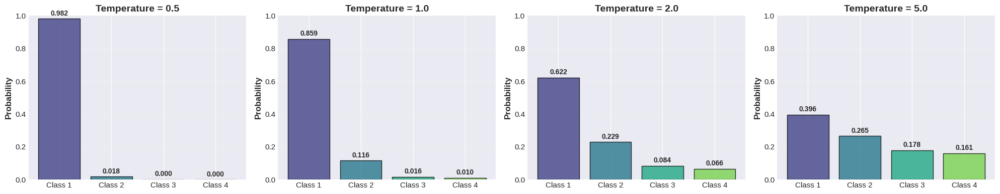


📊 Observation:
- Low T: Distribution is sharp (high confidence in top class)
- High T: Distribution is smooth (more uncertain, explores more)


In [ ]:
def plot_temperature_comparison(logits, temperatures):
    """
    Create a comparison plot showing softmax outputs for different temperatures.
    """
    n_temps = len(temperatures)
    fig, axes = plt.subplots(1, n_temps, figsize=(5*n_temps, 4))

    if n_temps == 1:
        axes = [axes]

    colors = plt.cm.viridis(np.linspace(0.2, 0.8, len(logits)))
    class_names = [f'Class {i+1}' for i in range(len(logits))]

    for idx, T in enumerate(temperatures):
        probs = softmax(logits, temperature=T)

        axes[idx].bar(class_names, probs, color=colors, alpha=0.8, edgecolor='black')
        axes[idx].set_ylim(0, 1)
        axes[idx].set_ylabel('Probability', fontsize=12, fontweight='bold')
        axes[idx].set_title(f'Temperature = {T}', fontsize=14, fontweight='bold')
        axes[idx].grid(axis='y', alpha=0.3)

        # Add probability values on bars
        for i, (prob, class_name) in enumerate(zip(probs, class_names)):
            axes[idx].text(i, prob + 0.02, f'{prob:.3f}',
                          ha='center', fontsize=10, fontweight='bold')

    plt.tight_layout()
    return fig

# Example: Compare different temperatures
logits = np.array([5.0, 3.0, 1.0, 0.5])
temperatures = [0.5, 1.0, 2.0, 5.0]
fig = plot_temperature_comparison(logits, temperatures)
plt.show()

print("\n📊 Observation:")
print("- Low T: Distribution is sharp (high confidence in top class)")
print("- High T: Distribution is smooth (more uncertain, explores more)")

In [ ]:
#Legal doc:low temp
#Story book: high

### Animation: Temperature Sweep

In [ ]:
def create_temperature_animation(logits, temperature_range=(0.1, 10), n_frames=100):
    """
    Create an animation showing how probabilities change with temperature.
    """
    temperatures = np.linspace(temperature_range[0], temperature_range[1], n_frames)
    class_names = [f'Class {i+1}' for i in range(len(logits))]
    colors = plt.cm.viridis(np.linspace(0.2, 0.8, len(logits)))

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

    # Initialize plots
    probs_init = softmax(logits, temperature=temperatures[0])
    bars = ax1.bar(class_names, probs_init, color=colors, alpha=0.8, edgecolor='black')
    ax1.set_ylim(0, 1)
    ax1.set_ylabel('Probability', fontsize=12, fontweight='bold')
    ax1.set_xlabel('Classes', fontsize=12, fontweight='bold')
    title = ax1.set_title(f'Temperature = {temperatures[0]:.2f}', fontsize=14, fontweight='bold')
    ax1.grid(axis='y', alpha=0.3)

    # Entropy plot
    entropies = []
    line, = ax2.plot([], [], 'b-', linewidth=2)
    ax2.set_xlim(temperature_range[0], temperature_range[1])
    ax2.set_ylim(0, np.log(len(logits)) * 1.1)
    ax2.set_xlabel('Temperature', fontsize=12, fontweight='bold')
    ax2.set_ylabel('Entropy (bits)', fontsize=12, fontweight='bold')
    ax2.set_title('Distribution Entropy vs Temperature', fontsize=14, fontweight='bold')
    ax2.grid(alpha=0.3)
    ax2.axhline(y=np.log(len(logits)), color='r', linestyle='--',
                label='Max Entropy (Uniform)', linewidth=2)
    ax2.legend()

    # Text annotations
    text_objects = []
    for i, bar in enumerate(bars):
        text = ax1.text(i, 0, '', ha='center', fontsize=10, fontweight='bold')
        text_objects.append(text)

    def animate(frame):
        T = temperatures[frame]
        probs = softmax(logits, temperature=T)

        # Update bar heights
        for bar, prob in zip(bars, probs):
            bar.set_height(prob)

        # Update text annotations
        for text, prob in zip(text_objects, probs):
            text.set_text(f'{prob:.3f}')
            text.set_y(prob + 0.02)

        # Update title
        title.set_text(f'Temperature = {T:.2f}')

        # Update entropy plot
        entropy = -np.sum(probs * np.log(probs + 1e-10))
        if frame >= len(entropies):
            entropies.append(entropy)
        line.set_data(temperatures[:len(entropies)], entropies)
        return [*bars, *text_objects, title, line]

    anim = FuncAnimation(fig, animate, frames=n_frames,
                        interval=50, blit=True, repeat=True)
    plt.close(fig)
    return HTML(anim.to_jshtml())

# Create animation
logits = np.array([4.0, 2.5, 1.0, 0.2])
print("🎬 Generating animation... (this may take a moment)")
anim = create_temperature_animation(logits, temperature_range=(0.1, 10), n_frames=80)
display(anim)

🎬 Generating animation... (this may take a moment)


### Application in  Language Model Sampling

In **text generation**, temperature controls creativity vs. determinism:
- **Low T** ($T < 1$): Conservative, predictable text
- **High T** ($T > 1$): Creative, diverse text

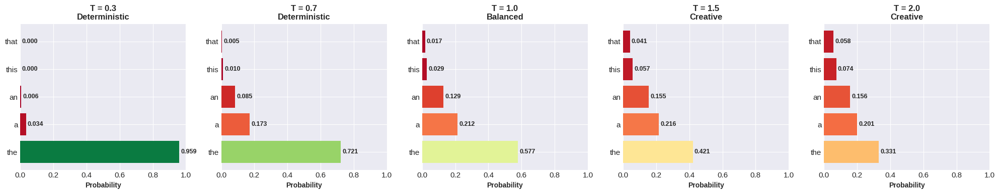


📝 Application:
- T = 0.3: Factual writing, technical docs
- T = 1.0: General purpose text generation
- T = 2.0: Creative writing, brainstorming


In [ ]:
def simulate_language_model_sampling():
    """
    Simulate how temperature affects next-token prediction in language models.
    """
    # Simulated logits for next word prediction
    words = ['the', 'a', 'an', 'this', 'that', 'my', 'our', 'his', 'her', 'its']
    logits = np.array([5.0, 4.0, 3.5, 2.0, 1.5, 1.0, 0.8, 0.5, 0.3, 0.1])

    temperatures = [0.3, 0.7, 1.0, 1.5, 2.0]

    fig, axes = plt.subplots(1, len(temperatures), figsize=(20, 4))

    for idx, T in enumerate(temperatures):
        probs = softmax(logits, temperature=T)

        # Plot top 5 words
        top_k = 5
        top_indices = np.argsort(probs)[-top_k:][::-1]

        axes[idx].barh(range(top_k), probs[top_indices],
                      color=plt.cm.RdYlGn(probs[top_indices]))
        axes[idx].set_yticks(range(top_k))
        axes[idx].set_yticklabels([words[i] for i in top_indices])
        axes[idx].set_xlabel('Probability', fontsize=10, fontweight='bold')
        axes[idx].set_title(f'T = {T}\n{"Deterministic" if T < 1 else "Balanced" if T == 1 else "Creative"}',
                           fontsize=12, fontweight='bold')
        axes[idx].set_xlim(0, 1)

        # Add probability labels
        for i, (prob, idx_word) in enumerate(zip(probs[top_indices], top_indices)):
            axes[idx].text(prob + 0.01, i, f'{prob:.3f}',
                          va='center', fontsize=9, fontweight='bold')

    plt.tight_layout()
    plt.show()

    print("\n📝 Application:")
    print("- T = 0.3: Factual writing, technical docs")
    print("- T = 1.0: General purpose text generation")
    print("- T = 2.0: Creative writing, brainstorming")

simulate_language_model_sampling()

## Summary

### Key Takeaways

1. **Temperature in softmax** controls the "sharpness" of probability distributions

2. **Low temperature** ($T < 1$):
   - Sharp, peaked distributions
   - High confidence predictions
   - Useful for: greedy decoding, deterministic outputs, exploitation

3. **High temperature** ($T > 1$):
   - Smooth, flat distributions
   - More uniform probabilities
   - Useful for: exploration, knowledge distillation, creative generation

4. **Applications**:
   - Language models: Control creativity in text generation
   - Knowledge distillation: Preserve class relationships
   - Reinforcement learning: Balance exploration vs exploitation
   - Calibration: Adjust model confidence

### Formula

$$
\text{softmax}_T(z_i) = \frac{e^{z_i/T}}{\sum_{j=1}^{n} e^{z_j/T}}
$$

where $T$ is the temperature parameter.

---

### Further Reading

- [Distilling the Knowledge in a Neural Network](https://arxiv.org/abs/1503.02531) (Hinton et al., 2015)
- [The Curious Case of Neural Text Degeneration](https://arxiv.org/abs/1904.09751) (Holtzman et al., 2019)
- [Calibrating Deep Neural Networks](https://arxiv.org/abs/1706.04599) (Guo et al., 2017)

## Continuing on Decoding Strategies

---

## 🏃‍♂️ Method 1: Greedy Search

### Overview

**Greedy Search** is the simplest decoding strategy:
- At each step, select the token with the **highest probability**
- No backtracking or reconsideration

### Pros:
- ✅ Fast and efficient
- ✅ Deterministic (same input = same output)
- ✅ Low memory footprint

### Cons:
- ❌ Myopic: doesn't consider long-term consequences
- ❌ Can get stuck in repetitive patterns
- ❌ May miss better overall sequences

### Algorithm:

```
1. Start with input tokens
2. While not done:
   a. Get probability distribution for next token
   b. Select token with argmax(probability)
   c. Append token to sequence
3. Return sequence
```

In [ ]:
def get_log_prob(logits, token_id):
    """Calculate log probability of a specific token."""
    probabilities = torch.nn.functional.softmax(logits, dim=-1)
    log_probabilities = torch.log(probabilities)
    return log_probabilities[token_id].item()

def greedy_search_with_tracking(input_text, max_new_tokens=5):
    """
    Perform greedy search and track the decision process.
    """
    input_ids = tokenizer.encode(input_text, return_tensors='pt').to(device)

    sequence = [input_text]
    tokens_info = []

    current_ids = input_ids

    with torch.no_grad():
        for step in range(max_new_tokens):
            # Get model predictions
            outputs = model(current_ids)
            logits = outputs.logits[0, -1, :]

            # Get probabilities
            probs = torch.nn.functional.softmax(logits, dim=-1)

            # Greedy selection
            token_id = torch.argmax(logits).unsqueeze(0)
            token = tokenizer.decode(token_id)

            # Track info
            token_prob = probs[token_id].item()
            tokens_info.append({
                'step': step + 1,
                'token': token,
                'probability': token_prob * 100,
                'log_prob': np.log(token_prob)
            })

            # Update sequence
            current_ids = torch.cat([current_ids, token_id.unsqueeze(0)], dim=-1)
            sequence.append(token)

    return ''.join(sequence), tokens_info

# Generate text with greedy search
text = "I have a dream"
generated_text, tokens_info = greedy_search_with_tracking(text, max_new_tokens=5)

print(f"\n{'='*60}")
print(f"🔹 GREEDY SEARCH RESULTS")
print(f"{'='*60}")
print(f"\nInput: '{text}'")
print(f"Generated: '{generated_text}'")
print(f"\n{'Step':<6} {'Token':<15} {'Probability':<15}")
print(f"{'-'*36}")
for info in tokens_info:
    print(f"{info['step']:<6} {info['token']:<15} {info['probability']:>6.2f}%")


🔹 GREEDY SEARCH RESULTS

Input: 'I have a dream'
Generated: 'I have a dream of being a doctor.'

Step   Token           Probability    
------------------------------------
1       of              15.21%
2       being            9.68%
3       a               30.59%
4       doctor           2.86%
5      .                22.93%


In [ ]:
def animate_greedy_search(text="I have a dream", max_new_tokens=5, show_top_k=10):
    """
    Animate the greedy search process step by step.
    """
    input_ids = tokenizer.encode(text, return_tensors='pt').to(device)

    # Generate sequence and collect data
    all_steps = []
    current_ids = input_ids
    current_text = text

    with torch.no_grad():
        for step in range(max_new_tokens):
            outputs = model(current_ids)
            logits = outputs.logits[0, -1, :]
            probs = torch.nn.functional.softmax(logits, dim=-1)

            # Get top k tokens
            top_probs, top_indices = torch.topk(probs, show_top_k)
            top_tokens = [tokenizer.decode([idx]) for idx in top_indices.tolist()]

            # Greedy choice (top 1)
            selected_token_id = torch.argmax(logits)
            selected_token = tokenizer.decode([selected_token_id])

            all_steps.append({
                'text': current_text,
                'probs': top_probs.cpu().numpy(),
                'tokens': top_tokens,
                'selected': selected_token
            })

            # Update for next iteration
            current_text += selected_token
            current_ids = torch.cat([current_ids, selected_token_id.unsqueeze(0).unsqueeze(0)], dim=-1)

    # Create animation
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(14, 10), facecolor='white')

    def animate(frame):
        if frame < len(all_steps):
            step_data = all_steps[frame]

            # Top plot: Current sequence
            ax1.clear()
            ax1.text(0.5, 0.5, f"Current: {step_data['text']}",
                    ha='center', va='center', fontsize=16, fontweight='bold',
                    bbox=dict(boxstyle='round', facecolor='lightblue', alpha=0.8))
            ax1.axis('off')
            ax1.set_title(f'Greedy Search - Step {frame + 1}/{len(all_steps)}',
                         fontsize=14, fontweight='bold', pad=20)

            # Bottom plot: Probability distribution
            ax2.clear()
            colors = ['red' if i == 0 else 'steelblue' for i in range(len(step_data['tokens']))]
            bars = ax2.bar(range(len(step_data['tokens'])),
                          step_data['probs'] * 100,
                          color=colors, alpha=0.7)

            ax2.set_xlabel('Token Options', fontsize=12, fontweight='bold')
            ax2.set_ylabel('Probability (%)', fontsize=12, fontweight='bold')
            ax2.set_title('Top Candidates (Red = Selected)', fontsize=12, fontweight='bold')
            ax2.set_xticks(range(len(step_data['tokens'])))
            ax2.set_xticklabels(step_data['tokens'], rotation=45, ha='right')
            ax2.grid(True, alpha=0.3, axis='y')

            # Add probability labels
            for i, (bar, prob) in enumerate(zip(bars, step_data['probs'])):
                height = bar.get_height()
                if i < 3:  # Label top 3
                    ax2.text(bar.get_x() + bar.get_width()/2., height,
                            f'{prob*100:.1f}%',
                            ha='center', va='bottom', fontsize=10, fontweight='bold')

        plt.tight_layout()
        return ax1, ax2

    anim = FuncAnimation(fig, animate, frames=len(all_steps), interval=1500, repeat=True)
    plt.close()

    return HTML(anim.to_jshtml())

# Run animation
animate_greedy_search()

<Figure size 1200x600 with 0 Axes>

In [ ]:
text = "I have a dream"
input_ids = tokenizer.encode(text, return_tensors='pt').to(device)

outputs = model.generate(input_ids, max_length=len(input_ids.squeeze())+5)
generated_text = tokenizer.decode(outputs[0], skip_special_tokens=True)
print(f"Generated text: {generated_text}")

The attention mask and the pad token id were not set. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.
Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.
The attention mask is not set and cannot be inferred from input because pad token is same as eos token. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.


Generated text: I have a dream of being a doctor.


In [ ]:
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import time

def get_log_prob(logits, token_id):
    # Compute the softmax of the logits
    probabilities = torch.nn.functional.softmax(logits, dim=-1)
    log_probabilities = torch.log(probabilities)

    # Get the log probability of the token
    token_log_probability = log_probabilities[token_id].item()
    return token_log_probability

def greedy_search(input_ids, node, length=5):
    if length == 0:
        return input_ids

    outputs = model(input_ids)
    predictions = outputs.logits

    # Get the predicted next sub-word (here we use top-k search)
    logits = predictions[0, -1, :]
    token_id = torch.argmax(logits).unsqueeze(0)

    # Compute the score of the predicted token
    token_score = get_log_prob(logits, token_id)

    # Add the predicted token to the list of input ids
    new_input_ids = torch.cat([input_ids, token_id.unsqueeze(0)], dim=-1)

    # Add node and edge to graph
    next_token = tokenizer.decode(token_id, skip_special_tokens=True)
    current_node = list(graph.successors(node))[0]
    graph.nodes[current_node]['tokenscore'] = np.exp(token_score) * 100
    graph.nodes[current_node]['token'] = next_token + f"_{length}"

    # Recursive call
    input_ids = greedy_search(new_input_ids, current_node, length-1)

    return input_ids

# Parameters
length = 5
beams = 1

# Create a balanced tree with height 'length'
graph = nx.balanced_tree(1, length, create_using=nx.DiGraph())

# Add 'tokenscore', 'cumscore', and 'token' attributes to each node
for node in graph.nodes:
    graph.nodes[node]['tokenscore'] = 100
    graph.nodes[node]['token'] = text

# Start generating text
output_ids = greedy_search(input_ids, 0, length=length)
output = tokenizer.decode(output_ids.squeeze().tolist(), skip_special_tokens=True)
print(f"Generated text: {output}")


Generated text: I have a dream of being a doctor.


In [ ]:
!pip install pygraphviz -q


  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


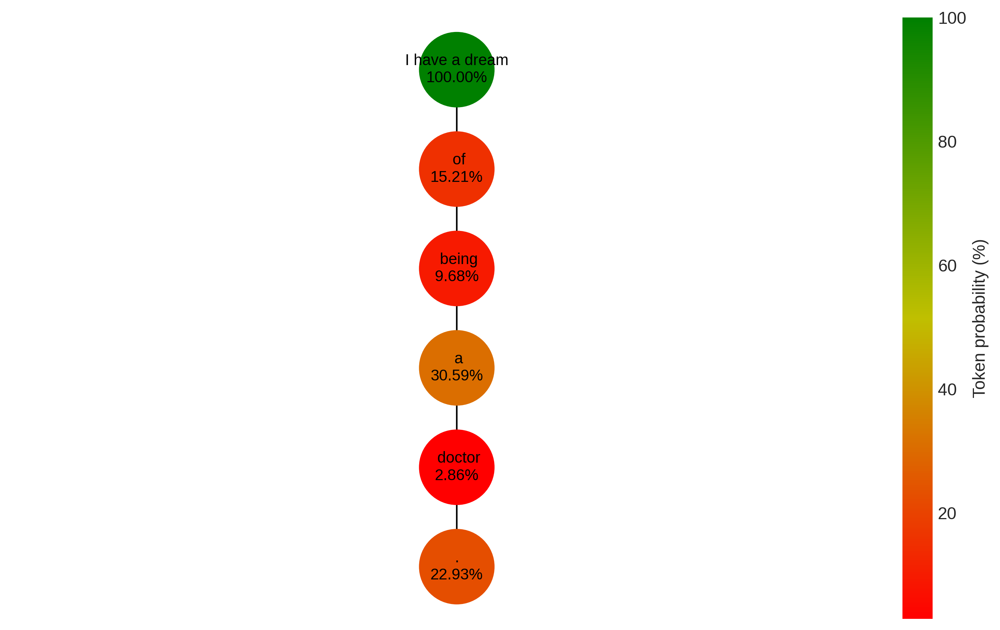

In [ ]:
import matplotlib.pyplot as plt
import networkx as nx
import matplotlib.colors as mcolors
from matplotlib.colors import LinearSegmentedColormap

def plot_graph(graph, length, beams, score):
    fig, ax = plt.subplots(figsize=(3+1.2*beams**length, max(5, 2+length)), dpi=300, facecolor='white')

    # Create positions for each node
    pos = nx.nx_agraph.graphviz_layout(graph, prog="dot")

    # Normalize the colors along the range of token scores
    if score == 'token':
        scores = [data['tokenscore'] for _, data in graph.nodes(data=True) if data['token'] is not None]
    elif score == 'sequence':
        scores = [data['sequencescore'] for _, data in graph.nodes(data=True) if data['token'] is not None]
    vmin = min(scores)
    vmax = max(scores)
    norm = mcolors.Normalize(vmin=vmin, vmax=vmax)
    cmap = LinearSegmentedColormap.from_list('rg', ["r", "y", "g"], N=256)

    # Draw the nodes
    nx.draw_networkx_nodes(graph, pos, node_size=2000, node_shape='o', alpha=1, linewidths=4,
                          node_color=scores, cmap=cmap)

    # Draw the edges
    nx.draw_networkx_edges(graph, pos)

    # Draw the labels
    if score == 'token':
        labels = {node: data['token'].split('_')[0] + f"\n{data['tokenscore']:.2f}%" for node, data in graph.nodes(data=True) if data['token'] is not None}
    elif score == 'sequence':
        labels = {node: data['token'].split('_')[0] + f"\n{data['sequencescore']:.2f}" for node, data in graph.nodes(data=True) if data['token'] is not None}
    nx.draw_networkx_labels(graph, pos, labels=labels, font_size=10)
    plt.box(False)

    # Add a colorbar
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    if score == 'token':
        fig.colorbar(sm, ax=ax, orientation='vertical', pad=0, label='Token probability (%)')
    elif score == 'sequence':
        fig.colorbar(sm, ax=ax, orientation='vertical', pad=0, label='Sequence score')
    plt.show()

# Plot graph
plot_graph(graph, length, 1.5, 'token')


### 💡 Key Insight: The Greedy Problem

Notice how greedy search might pick tokens with low probability (like 2.86% for "doctor"). This happens because:
- Each decision is independent
- Earlier "greedy" choices constrain later options
- No consideration of the overall sequence quality

**Question**: Could a slightly less probable token early on lead to a better overall sequence?

This is where **Beam Search** comes in!

---

## ⚖️ Method 2: Beam Search

### Overview

**Beam Search** maintains multiple hypotheses (beams) simultaneously:
- At each step, consider the top **n** tokens (where n = beam width)
- Keep track of n best sequences based on cumulative score
- After generation completes, return the sequence with highest overall score

### Scoring Function:

$$\text{score}(w) = \frac{1}{|w|} \sum_{i=1}^{|w|} \log P(w_i | w_1, \ldots, w_{i-1})$$

We use:
- **Log probabilities** (easier to compute, avoid underflow)
- **Length normalization** (prevent bias toward shorter sequences)

### Pros:
- ✅ Considers multiple paths simultaneously
- ✅ Better at finding high-quality sequences
- ✅ More reliable than greedy for translation, summarization

### Cons:
- ❌ More computationally expensive (O(beam_width))
- ❌ Still can produce generic/repetitive text
- ❌ May not be diverse enough for creative tasks

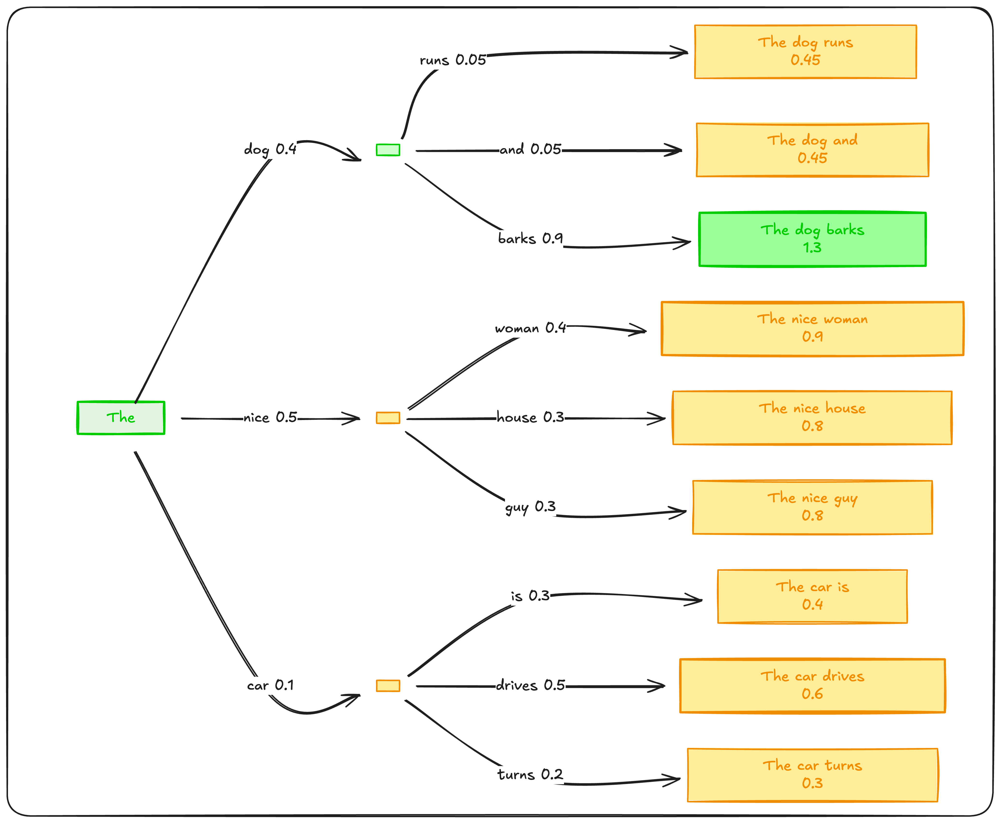

In [ ]:
from tqdm.notebook import tqdm

def greedy_sampling(logits, beams):
    return torch.topk(logits, beams).indices

def beam_search(input_ids, node, bar, length, beams, sampling, temperature=0.1):
    if length == 0:
        return None

    outputs = model(input_ids)
    predictions = outputs.logits

    # Get the predicted next sub-word (here we use top-k search)
    logits = predictions[0, -1, :]

    if sampling == 'greedy':
        top_token_ids = greedy_sampling(logits, beams)
    elif sampling == 'top_k':
        top_token_ids = top_k_sampling(logits, temperature, 20, beams)
    elif sampling == 'nucleus':
        top_token_ids = nucleus_sampling(logits, temperature, 0.5, beams)

    for j, token_id in enumerate(top_token_ids):
        bar.update(1)

        # Compute the score of the predicted token
        token_score = get_log_prob(logits, token_id)
        cumulative_score = graph.nodes[node]['cumscore'] + token_score

        # Add the predicted token to the list of input ids
        new_input_ids = torch.cat([input_ids, token_id.unsqueeze(0).unsqueeze(0)], dim=-1)

        # Add node and edge to graph
        token = tokenizer.decode(token_id, skip_special_tokens=True)
        current_node = list(graph.successors(node))[j]
        graph.nodes[current_node]['tokenscore'] = np.exp(token_score) * 100
        graph.nodes[current_node]['cumscore'] = cumulative_score
        graph.nodes[current_node]['sequencescore'] = 1/(len(new_input_ids.squeeze())) * cumulative_score
        graph.nodes[current_node]['token'] = token + f"_{length}_{j}"

        # Recursive call
        beam_search(new_input_ids, current_node, bar, length-1, beams, sampling, 1)

# Parameters
length = 5
beams = 2

# Create a balanced tree with height 'length' and branching factor 'k'
graph = nx.balanced_tree(beams, length, create_using=nx.DiGraph())
bar = tqdm(total=len(graph.nodes))

# Add 'tokenscore', 'cumscore', and 'token' attributes to each node
for node in graph.nodes:
    graph.nodes[node]['tokenscore'] = 100
    graph.nodes[node]['cumscore'] = 0
    graph.nodes[node]['sequencescore'] = 0
    graph.nodes[node]['token'] = text

# Start generating text
beam_search(input_ids, 0, bar, length, beams, 'greedy', 1)


  0%|          | 0/63 [00:00<?, ?it/s]

In [ ]:
def get_best_sequence(G):
    # Create a list of leaf nodes
    leaf_nodes = [node for node in G.nodes() if G.out_degree(node)==0]

    # Get the leaf node with the highest cumscore
    max_score_node = None
    max_score = float('-inf')
    for node in leaf_nodes:
        if G.nodes[node]['sequencescore'] > max_score:
            max_score = G.nodes[node]['sequencescore']
            max_score_node = node

    # Retrieve the sequence of nodes from this leaf node to the root node in a list
    path = nx.shortest_path(G, source=0, target=max_score_node)

    # Return the string of token attributes of this sequence
    sequence = "".join([G.nodes[node]['token'].split('_')[0] for node in path])

    return sequence, max_score

sequence, max_score = get_best_sequence(graph)
print(f"Generated text: {sequence}")


Generated text: I have a dream. I have a dream


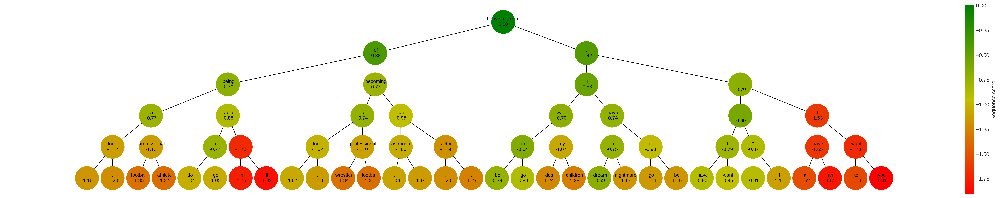

In [ ]:
# Plot graph
plot_graph(graph, length, beams, 'sequence')


[Beam Search Visualizer](https://huggingface.co/spaces/m-ric/beam_search_visualizer)

---

## 🎲 Method 3: Top-k Sampling

### Overview

**Top-k Sampling** introduces controlled randomness:
1. Consider only the top **k** most likely tokens
2. **Randomly sample** from these k tokens based on their probabilities
3. Ignore all other tokens (set their probability to 0)

### The Role of Temperature

Temperature $T$ controls randomness:

$$P(w_i) = \frac{\exp(z_i / T)}{\sum_j \exp(z_j / T)}$$

Where $z_i$ are the logits.

- **T = 1.0**: Standard softmax (default)
- **T < 1.0** (e.g., 0.1): More confident, peaked distribution
- **T > 1.0** (e.g., 2.0): Flatter, more random distribution

### Pros:
- ✅ More diverse outputs than greedy/beam search
- ✅ Simple to implement and understand
- ✅ Good for creative tasks (story generation, brainstorming)

### Cons:
- ❌ Fixed k doesn't adapt to situation
- ❌ May still include low-quality tokens
- ❌ Choosing k is task-dependent

In [ ]:
def plot_prob_distribution(probabilities, next_tokens, sampling, potential_nb, total_nb=50):
    # Get top k tokens
    top_k_prob, top_k_indices = torch.topk(probabilities, total_nb)
    top_k_tokens = [tokenizer.decode([idx]) for idx in top_k_indices.tolist()]

    # Get next tokens and their probabilities
    next_tokens_list = [tokenizer.decode([idx]) for idx in next_tokens.tolist()]
    next_token_prob = probabilities[next_tokens].tolist()

    # Create figure
    plt.figure(figsize=(0.4*total_nb, 5), dpi=300, facecolor='white')
    plt.rc('axes', axisbelow=True)
    plt.grid(axis='y', linestyle='-', alpha=0.5)
    if potential_nb < total_nb:
        plt.axvline(x=potential_nb-0.5, ls=':', color='grey', label='Sampled tokens')
    plt.bar(top_k_tokens, top_k_prob.tolist(), color='blue')
    plt.bar(next_tokens_list, next_token_prob, color='red', label='Selected tokens')
    plt.xticks(rotation=45, ha='right', va='top')
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    if sampling == 'top_k':
        plt.title('Probability distribution of predicted tokens with top-k sampling')
    elif sampling == 'nucleus':
        plt.title('Probability distribution of predicted tokens with nucleus sampling')
    plt.legend()
    plt.savefig(f'{sampling}_{time.time()}.png', dpi=300)
    plt.close()

def top_k_sampling(logits, temperature, top_k, beams, plot=True):
    assert top_k >= 1
    assert beams <= top_k

    indices_to_remove = logits < torch.topk(logits, top_k)[0][..., -1, None]
    new_logits = torch.clone(logits)
    new_logits[indices_to_remove] = float('-inf')

    # Convert logits to probabilities
    probabilities = torch.nn.functional.softmax(new_logits / temperature, dim=-1)

    # Sample n tokens from the resulting distribution
    next_tokens = torch.multinomial(probabilities, beams)

    # Plot distribution
    if plot:
        total_prob = torch.nn.functional.softmax(logits / temperature, dim=-1)
        plot_prob_distribution(total_prob, next_tokens, 'top_k', top_k)

    return next_tokens

# Start generating text
beam_search(input_ids, 0, bar, length, beams, 'top_k', 1)


In [ ]:
sequence, max_score = get_best_sequence(graph)
print(f"Generated text: {sequence}")


Generated text: I have a dream that someday I'll be


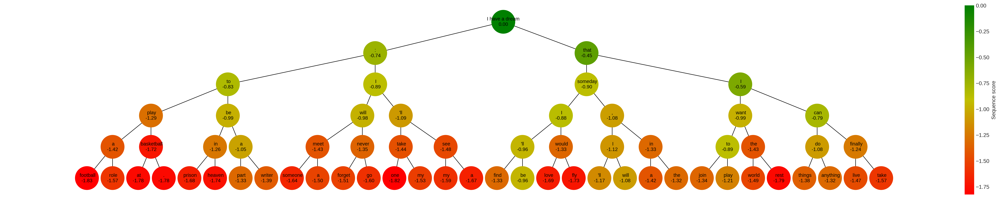

In [ ]:
# Plot graph
plot_graph(graph, length, beams, 'sequence')


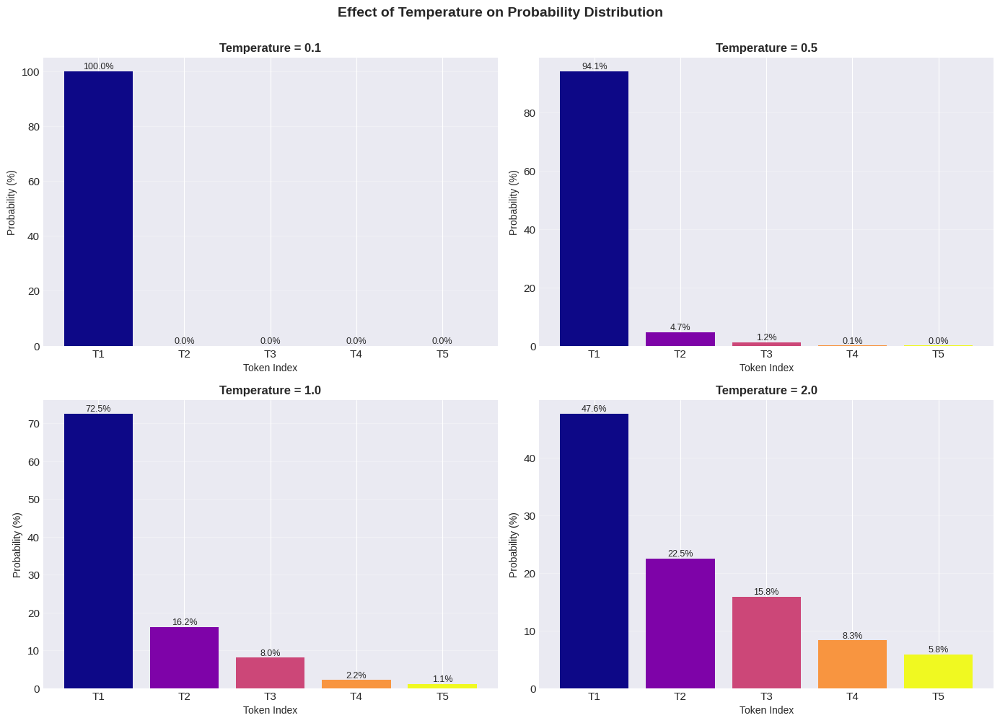


💡 Interpretation:
  • Low temp (0.1): Model is very confident, almost deterministic
  • Moderate temp (1.0): Balanced between confidence and diversity
  • High temp (2.0): More uniform distribution, more random


In [ ]:
def plot_temperature_effect(logits_values=None):
    """
    Interactive visualization of temperature effects on probability distribution.
    """
    if logits_values is None:
        logits_values = [3.0, 1.5, 0.8, -0.5, -1.2]

    logits = torch.tensor(logits_values)
    temperatures = [0.1, 0.5, 1.0, 2.0]

    fig, axes = plt.subplots(2, 2, figsize=(14, 10), facecolor='white')
    axes = axes.flatten()

    for idx, temp in enumerate(temperatures):
        probs = torch.nn.functional.softmax(logits / temp, dim=-1)

        ax = axes[idx]
        bars = ax.bar(range(len(logits)), probs.numpy() * 100,
                     color=plt.cm.plasma(np.linspace(0, 1, len(logits))))

        ax.set_title(f'Temperature = {temp}', fontsize=12, fontweight='bold')
        ax.set_ylabel('Probability (%)', fontsize=10)
        ax.set_xlabel('Token Index', fontsize=10)
        ax.set_xticks(range(len(logits)))
        ax.set_xticklabels([f'T{i+1}' for i in range(len(logits))])
        ax.grid(True, alpha=0.3, axis='y')

        # Add value labels
        for i, (bar, prob) in enumerate(zip(bars, probs)):
            height = bar.get_height()
            ax.text(bar.get_x() + bar.get_width()/2., height,
                   f'{prob.item()*100:.1f}%',
                   ha='center', va='bottom', fontsize=9)

    plt.suptitle('Effect of Temperature on Probability Distribution',
                fontsize=14, fontweight='bold', y=1.00)
    plt.tight_layout()
    plt.show()

# Plot temperature effects
plot_temperature_effect()

print("\n💡 Interpretation:")
print("  • Low temp (0.1): Model is very confident, almost deterministic")
print("  • Moderate temp (1.0): Balanced between confidence and diversity")
print("  • High temp (2.0): More uniform distribution, more random")

---

## 🔬 Method 4: Nucleus (Top-p) Sampling

### Overview

**Nucleus Sampling** (also called **top-p sampling**) is more adaptive:
1. Sort tokens by probability (descending)
2. Keep adding tokens until cumulative probability exceeds threshold **p**
3. Sample from this dynamic "nucleus" of tokens

### Key Difference from Top-k:

- **Top-k**: Fixed number of tokens (k)
- **Top-p**: Variable number based on probability mass

### Example:

With p = 0.9:
- If top token has 95% probability → nucleus = 1 token
- If probabilities are [30%, 25%, 20%, 15%, 10%] → nucleus = 4 tokens

### Algorithm:

```python
1. Sort tokens by P(token) descending
2. cumsum = 0
3. nucleus = []
4. for token in sorted_tokens:
       cumsum += P(token)
       nucleus.append(token)
       if cumsum >= p:
           break
5. Sample from nucleus
```

### Pros:
- ✅ Dynamically adapts to confidence level
- ✅ More robust across different contexts
- ✅ Better quality-diversity tradeoff
- ✅ State-of-the-art for many generation tasks

### Cons:
- ❌ Slightly more complex to implement
- ❌ p parameter still needs tuning

In [ ]:
def nucleus_sampling(logits, temperature, p, beams, plot=True):
    assert p > 0
    assert p <= 1

    # Sort the probabilities in descending order and compute cumulative probabilities
    sorted_logits, sorted_indices = torch.sort(logits, descending=True)
    probabilities = torch.nn.functional.softmax(sorted_logits / temperature, dim=-1)
    cumulative_probabilities = torch.cumsum(probabilities, dim=-1)

    # Create a mask for probabilities that are in the top-p
    mask = cumulative_probabilities < p

    # If there's not n index where cumulative_probabilities < p, we use the top n tokens instead
    if mask.sum() > beams:
        top_p_index_to_keep = torch.where(mask)[0][-1].detach().cpu().tolist()
    else:
        top_p_index_to_keep = beams

    # Only keep top-p indices
    indices_to_remove = sorted_indices[top_p_index_to_keep:]
    sorted_logits[indices_to_remove] = float('-inf')

    # Sample n tokens from the resulting distribution
    probabilities = torch.nn.functional.softmax(sorted_logits / temperature, dim=-1)
    next_tokens = torch.multinomial(probabilities, beams)

    # Plot distribution
    if plot:
        total_prob = torch.nn.functional.softmax(logits / temperature, dim=-1)
        plot_prob_distribution(total_prob, next_tokens, 'nucleus', top_p_index_to_keep)

    return next_tokens

# Start generating text
beam_search(input_ids, 0, bar, length, beams, 'nucleus', 1)


In [ ]:
sequence, max_score = get_best_sequence(graph)
print(f"Generated text: {sequence}")


Generated text: I have a dream. I have a dream


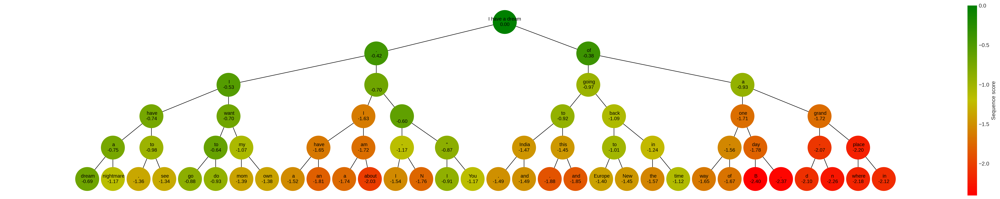

In [ ]:
# Plot graph
plot_graph(graph, length, beams, 'sequence')


---

## 🎯 Summary & Best Practices

### Quick Decision Guide:

| Task Type | Best Strategy | Typical Parameters |
|-----------|---------------|--------------------|
| **Translation** | Beam Search | num_beams=5 |
| **Summarization** | Beam Search | num_beams=4, length_penalty=1.0 |
| **Question Answering** | Greedy or Beam | num_beams=1-3 |
| **Creative Writing** | Top-k or Nucleus | k=50, p=0.95, T=0.8-1.0 |
| **Code Generation** | Nucleus | p=0.95, T=0.2-0.5 |
| **Chatbots** | Nucleus | p=0.9, T=0.7 |
| **Data-to-Text** | Beam Search | num_beams=3-5 |

### Parameter Guidelines:

**Temperature (T)**:
- `0.1-0.5`: Very focused, deterministic outputs
- `0.5-1.0`: Balanced creativity and coherence ✅ **(Recommended default)**
- `1.0-2.0`: More creative, diverse, but potentially less coherent

**Top-k (k)**:
- `k=10-20`: Conservative, coherent
- `k=30-50`: Moderate diversity ✅ **(Recommended default)**
- `k=50+`: High diversity, more creative

**Top-p (p)**:
- `p=0.8-0.9`: More focused ✅ **(Good for factual tasks)**
- `p=0.92-0.95`: Balanced ✅ **(Recommended default)**
- `p=0.95-0.99`: More diverse ✅ **(Good for creative tasks)**

**Beam Width**:
- `beams=1`: Greedy search
- `beams=3-5`: Good tradeoff ✅ **(Recommended)**
- `beams=5-10`: Better quality but slower
- `beams=10+`: Diminishing returns

### Key Insights:

1. **Greedy Search**: Fast but myopic - use when speed matters more than quality

2. **Beam Search**: Best for tasks with "correct" answers (translation, summarization)

3. **Top-k Sampling**: Simple randomness - good baseline for creative tasks

4. **Nucleus Sampling**: Most versatile - adapts to model confidence ✅ **Recommended default**

5. **Combining Strategies**: You can use temperature with any sampling method!

### Common Pitfalls:

❌ **DON'T**:
- Use high temperature with greedy/beam search (they don't sample)
- Set both top-k and top-p (redundant - pick one)
- Use very high temperature (>1.5) without testing
- Ignore length penalties in beam search for long generations

✅ **DO**:
- Experiment with different strategies for your specific task
- Start with nucleus sampling (p=0.92, T=0.8) as baseline
- Use beam search for deterministic, factual tasks
- Monitor both quality and diversity in outputs
- Consider combining multiple generations and reranking

## Illustration using Phi

In [ ]:
from transformers import AutoModelForCausalLM, AutoTokenizer, pipeline
import torch

# Load Phi-3 Instruct model
model_name = "microsoft/Phi-3-mini-4k-instruct"

print("Loading Phi-3 model... (this may take a minute)")
tokenizer = AutoTokenizer.from_pretrained(model_name, trust_remote_code=True)
model = AutoModelForCausalLM.from_pretrained(
    model_name,
    torch_dtype=torch.float16,
    device_map="auto",
    trust_remote_code=True
)
print("✅ Phi-3 model loaded!")

# Helper function to generate with chat format
def generate_response(prompt, **gen_kwargs):
    """Generate response using Phi-3 with proper chat template"""
    messages = [{"role": "user", "content": prompt}]

    input_text = tokenizer.apply_chat_template(
        messages,
        tokenize=False,
        add_generation_prompt=True
    )
    inputs = tokenizer(input_text, return_tensors="pt").to(model.device)

    outputs = model.generate(
        **inputs,
        max_new_tokens=100,
        pad_token_id=tokenizer.eos_token_id,
        use_cache=False,
        **gen_kwargs
    )

    # Decode only the new tokens
    response = tokenizer.decode(outputs[0][inputs['input_ids'].shape[1]:], skip_special_tokens=True)
    return response.strip()

Loading Phi-3 model... (this may take a minute)


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

✅ Phi-3 model loaded!


#### Greedy Decoding

In [ ]:
prompt = "Write a short poem about the ocean."

# Run 3 times to show it's deterministic
for i in range(3):
    response = generate_response(
        prompt,
        do_sample=False  # Greedy - no sampling
    )
    print(f"Run {i+1}: {response[:150]}...")
    print("-"*50)
    print("-"*50)

Run 1: Whispers of the ocean's breath,

A symphony of waves, a dance with death.

Azure depths, a mystery untold,

In its embrace, the world's heart unfolds....
--------------------------------------------------
--------------------------------------------------
Run 2: Whispers of the ocean's breath,

A symphony of waves, a dance with death.

Azure depths, a mystery untold,

In its embrace, the world's heart unfolds....
--------------------------------------------------
--------------------------------------------------
Run 3: Whispers of the ocean's breath,

A symphony of waves, a dance with death.

Azure depths, a mystery untold,

In its embrace, the world's heart unfolds....
--------------------------------------------------
--------------------------------------------------


#### Temperature Compare

In [ ]:
prompt = "Give me 3 creative names for a coffee shop."
temperatures = [0.1, 0.5, 0.7, 1.0, 1.5]

for temp in temperatures:
    response = generate_response(
        prompt,
        do_sample=True,
        temperature=temp,
        top_p=1.0,  # Disable top_p to isolate temperature effect
        top_k=0     # Disable top_k
    )
    print(f"🌡️ Temperature = {temp}: {response[:200]}")
    print("-"*50)
    print("-"*50)

🌡️ Temperature = 0.1: 1. "Bean There, Done That"
2. "Caffeine Chronicles"
3. "Espresso Expressions"
--------------------------------------------------
--------------------------------------------------
🌡️ Temperature = 0.5: 1. Java Jive
2. Beans & Brews
3. The Caffeinated Corner
--------------------------------------------------
--------------------------------------------------
🌡️ Temperature = 0.7: 1. Bean Boulevard Café
2. Java Jive Juice Bar
3. The Grind & Gourmet
--------------------------------------------------
--------------------------------------------------
🌡️ Temperature = 1.0: 1. "The Morning Brew Haven"
2. "Caffeine Symphony Café"
3. "Beanscapes Espresso Emporium"
--------------------------------------------------
--------------------------------------------------
🌡️ Temperature = 1.5: - Juanovolina Blend  

Looks appel is super aesthetienne mari Vogels contrast, creates immediate soul conceptiu impressive rapid associ caIesis mix ggatiz cabsolute evolution sav breairs re

#### Top-K Sampling

In [ ]:
prompt = "The best programming language is"
top_k_values = [1, 5, 10, 50, 100]

for k in top_k_values:
    for run in range(2):  # 2 runs to show variation
        response = generate_response(
            prompt,
            do_sample=True,
            top_k=k,
            temperature=0.8,
            top_p=1.0  # Disable top_p to isolate top_k effect
        )
        print(f"🎯 top_k={k}, Run {run+1}: {response[:100]}...")
        print("-"*50)
        print("-"*50)

🎯 top_k=1, Run 1: The question of which programming language is the "best" is subjective and depends on various factor...
--------------------------------------------------
--------------------------------------------------
🎯 top_k=1, Run 2: The question of the "best" programming language is subjective and depends on various factors such as...
--------------------------------------------------
--------------------------------------------------
🎯 top_k=5, Run 1: Determining the "best" programming language depends on the context of the project or the user's pers...
--------------------------------------------------
--------------------------------------------------
🎯 top_k=5, Run 2: The question of the "best" programming language can be subjective, as it often depends on the contex...
--------------------------------------------------
--------------------------------------------------
🎯 top_k=10, Run 1: The concept of the "best" programming language is highly subjective and depends on th

#### Top-p(Nucleus) Sampling

In [ ]:
prompt = "A good weekend activity is"
top_p_values = [0.1, 0.5, 0.9, 0.95, 1.0]

for p in top_p_values:
    for run in range(2):
        response = generate_response(
            prompt,
            do_sample=True,
            top_p=p,
            temperature=0.8,
            top_k=0  # Disable top_k to isolate top_p effect
        )
        print(f"🎲 top_p={p}, Run {run+1}: {response[:100]}...")
        print("-"*50)
        print("-"*50)

🎲 top_p=0.1, Run 1: A good weekend activity can vary greatly depending on personal interests, location, and weather cond...
--------------------------------------------------
--------------------------------------------------
🎲 top_p=0.1, Run 2: A good weekend activity can vary greatly depending on personal interests, location, and weather cond...
--------------------------------------------------
--------------------------------------------------
🎲 top_p=0.5, Run 1: A good weekend activity depends on personal interests and local opportunities. Here are a few sugges...
--------------------------------------------------
--------------------------------------------------
🎲 top_p=0.5, Run 2: A good weekend activity depends on personal interests and local opportunities. However, here are som...
--------------------------------------------------
--------------------------------------------------
🎲 top_p=0.9, Run 1: A good weekend activity can vary greatly depending on personal interests and

#### Beam Search

In [ ]:
prompt = "Translate to French: The weather is beautiful today."
beam_values = [1, 2, 4, 6]

for num_beams in beam_values:
    response = generate_response(
        prompt,
        do_sample=False,  # Beam search doesn't use sampling
        num_beams=num_beams,
        early_stopping=True
    )
    print(f"🔍 num_beams={num_beams}: {response[:150]}")
    print("-"*50)
    print("-"*50)

🔍 num_beams=1: Le temps est magnifique aujourd'hui.
--------------------------------------------------
--------------------------------------------------
🔍 num_beams=2: Le temps est magnifique aujourd'hui.
--------------------------------------------------
--------------------------------------------------
🔍 num_beams=4: Le temps est magnifique aujourd'hui.
--------------------------------------------------
--------------------------------------------------
🔍 num_beams=6: Le temps est magnifique aujourd'hui.
--------------------------------------------------
--------------------------------------------------


#### Repetition Penalty

In [ ]:
prompt = "List things you can do at a park:"
penalties = [1.0, 1.1, 1.2, 1.5]

for penalty in penalties:
    response = generate_response(
        prompt,
        do_sample=True,
        temperature=0.8,
        top_p=0.9,
        repetition_penalty=penalty,
    )
    print(f"🔄 repetition_penalty={penalty}: {response[:200]}...")
    print("-"*50)
    print("-"*50)

🔄 repetition_penalty=1.0: 1. Go for a walk or run along designated paths.
2. Have a picnic with friends or family.
3. Play frisbee, soccer, or another sport.
4. Fly a kite on a windy day.
5. Enjoy a leisurely stroll and apprec...
--------------------------------------------------
--------------------------------------------------
🔄 repetition_penalty=1.1: At a park, there are many activities to enjoy. Some examples include picnicking with family or friends under the shade of trees; playing sports such as soccer, basketball, or frisbee on designated fie...
--------------------------------------------------
--------------------------------------------------
🔄 repetition_penalty=1.2: 1. Have picnics with family and friends
2. Go for walks or jogs along the trails/paths in your area of interest (either alone, as part-time hobbies) / nature exploration enthusiasts enjoy getting lost...
--------------------------------------------------
--------------------------------------------------
🔄 re


## OpenAI Chat Completions API Basics

* The Chat Completions API is OpenAI's primary interface for text generation.
* Requests use a `messages` array with role-based conversation format.
* The response object contains the generated content, usage stats, and metadata.

In [31]:
from openai import OpenAI

client = OpenAI() #OPENAIAPIKEY is already set

# Minimal working example
response = client.chat.completions.create(
    model="gpt-4o-mini",
    messages=[
        {"role": "user", "content": "What is the capital of France?"}
    ],
    #n=3 #
)

print(response.choices[0].message.content)

The capital of France is Paris.


In [11]:
response

ChatCompletion(id='chatcmpl-Cufk3eIJj8ixry9rxYlPIB9EANZtC', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='The capital of France is Paris.', refusal=None, role='assistant', annotations=[], audio=None, function_call=None, tool_calls=None))], created=1767622859, model='gpt-4o-mini-2024-07-18', object='chat.completion', service_tier='default', system_fingerprint='fp_29330a9688', usage=CompletionUsage(completion_tokens=7, prompt_tokens=14, total_tokens=21, completion_tokens_details=CompletionTokensDetails(accepted_prediction_tokens=0, audio_tokens=0, reasoning_tokens=0, rejected_prediction_tokens=0), prompt_tokens_details=PromptTokensDetails(audio_tokens=0, cached_tokens=0)))


**Output:**

```
The capital of France is Paris.
```

* The response object structure:
  
* `response.id`- Unique request identifier
  
* `response.choices[0].message.content`- Generated text
  
* `response.choices[0].finish_reason`- Why generation stopped (`stop`, `length`, `tool_calls`)
  
* `response.usage`- Token counts (prompt, completion, total)
---

## What This Output Represents

This object is a **model response choice** returned by a Chat Completions API call.  
It represents **one completed answer** generated by the assistant.

---

## Overall Structure

```text
[
  Choice(
    finish_reason='stop',
    index=0,
    logprobs=None,
    message=ChatCompletionMessage(...)
  )
]


In [ ]:
print(response.choices)

[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='The capital of France is Paris.', refusal=None, role='assistant', annotations=[], audio=None, function_call=None, tool_calls=None))]


### 3. Message Roles

- Messages use four distinct roles to structure conversations.
- Each role serves a specific purpose in guiding model behavior.

| Role        | Purpose                                   | Best Practice                                  |
|-------------|--------------------------------------------|-----------------------------------------------|
| `system`    | Sets AI behavior, personality, constraints | Place first; define output format              |
| `user`      | Human/end-user messages                    | Contains queries and context                  |
| `assistant` | Model's previous responses                 | Include for multi-turn context                |
| `tool`      | Function/tool responses                   | Return results with `tool_call_id`             |


#### Multi-Turn Conversation

In [ ]:
# Multi-turn conversation example
messages = [
    {
        "role": "system",
        "content": """You are a Python expert. Follow these rules:
        1. Provide concise, working code
        2. Include type hints
        3. Add brief inline comments"""
    },
    {
        "role": "user",
        "content": "Write a function to calculate factorial"
    },
    {
        "role": "assistant",
        "content": """```python
def factorial(n: int) -> int:
    if n <= 1:
        return 1
    return n * factorial(n - 1)
```"""
    },
    {
        "role": "user",
        "content": "Now add memoization to optimize it"
    }
]

In [ ]:
response = client.chat.completions.create(
    model="gpt-4o-mini",
    messages=messages
)

print(response.choices[0].message.content)

```python
from functools import lru_cache

@lru_cache(maxsize=None)  # Cache results to optimize repeated calls
def factorial(n: int) -> int:
    if n <= 1:
        return 1
    return n * factorial(n - 1)  # Recursive call
```


**Output:**
```python
from functools import lru_cache

@lru_cache(maxsize=None)
def factorial(n: int) -> int:
    # Handle base case with memoization for O(1) repeated calls
    if n <= 1:
        return 1
    return n * factorial(n - 1)
```

---

### 4. API Parameters Deep Dive

* Parameters control generation behavior, randomness, and output format.
* Understanding these enables fine-tuned control over model responses.

#### Core Parameters

| Parameter | Description | Default |
|-----------|-------------|---------|
| `model` | Model identifier (e.g., `gpt-4o`, `gpt-4o-mini`) | Required |
| `messages` | Conversation messages array | Required |
| `max_completion_tokens` | Maximum tokens to generate | Model default |
| `temperature` | Randomness: 0=deterministic, 2=creative | 1.0 |
| `top_p` | Nucleus sampling: consider top N% probability | 1.0 |
| `presence_penalty` | -2 to 2: penalize new topics | 0 |
| `frequency_penalty` | -2 to 2: penalize repeated tokens | 0 |
| `stop` | Stop sequences (up to 4) | None |
| `seed` | For reproducible outputs (best effort) | None |

In [ ]:
# Deterministic output (code generation, factual queries)
response = client.chat.completions.create(
    model="gpt-4o-mini",
    messages=[{"role": "user", "content": "Write a SQL query to select all users"}],
    temperature=0,  # Most deterministic
)

In [ ]:
# Creative output (storytelling, brainstorming)
response = client.chat.completions.create(
    model="gpt-4o-mini",
    messages=[{"role": "user", "content": "Write a creative haiku about coding"}],
    temperature=1.5,  # More creative
)

* **Temperature vs Top_p**: OpenAI recommends modifying only one, not both.
* **Presence penalty**: Encourages topic diversity (positive values).
* **Frequency penalty**: Reduces verbatim repetition (positive values).

---

###  Streaming Responses

* Streaming delivers responses token-by-token for real-time UIs.
* Reduces perceived latency from seconds to milliseconds.
* Enabled by setting `stream=True` in the API call.

In [ ]:
stream = client.chat.completions.create(
    model="gpt-4o-mini",
    messages=[{"role": "user", "content": "Explain machine learning in 3 sentences."}],
    stream=True
)

# Process tokens as they arrive
print("Response: ", end="")
for chunk in stream:
    if chunk.choices[0].delta.content is not None:
        print(chunk.choices[0].delta.content, end="", flush=True)
print()

Response: Machine learning is a subset of artificial intelligence that enables systems to learn from data and improve their performance over time without being explicitly programmed. It involves algorithms that identify patterns in data, allowing the model to make predictions or decisions based on new inputs. Machine learning is widely used in applications such as image recognition, natural language processing, and recommendation systems.


###  Structured Output using Pydantic

In [ ]:
from pydantic import BaseModel
from typing import List

class MovieReview(BaseModel):
    title: str
    rating: float
    pros: List[str]
    cons: List[str]

completion = client.beta.chat.completions.parse(
    model="gpt-4o-2024-08-06",
    messages=[{"role": "user", "content": "Review The Matrix"}],
    response_format=MovieReview
)

result = completion.choices[0].message.parsed
print(f"{result.title}: {result.rating}/10")

The Matrix: 4.5/10


###  Function Calling

In [ ]:
import json

tools = [{
    "type": "function",
    "function": {
        "name": "get_weather",
        "description": "Get weather for a city",
        "parameters": {
            "type": "object",
            "properties": {
                "city": {"type": "string"},
                "unit": {"type": "string", "enum": ["celsius", "fahrenheit"]}
            },
            "required": ["city"]
        }
    }
}]

response = client.chat.completions.create(
    model="gpt-4o-mini",
    messages=[{"role": "user", "content": "Weather in Paris?"}],
    tools=tools
)

if response.choices[0].message.tool_calls:
    tool_call = response.choices[0].message.tool_calls[0]
    args = json.loads(tool_call.function.arguments)
    print(f"Call {tool_call.function.name} with {args}")

Call get_weather with {'city': 'Paris'}


## Ollama

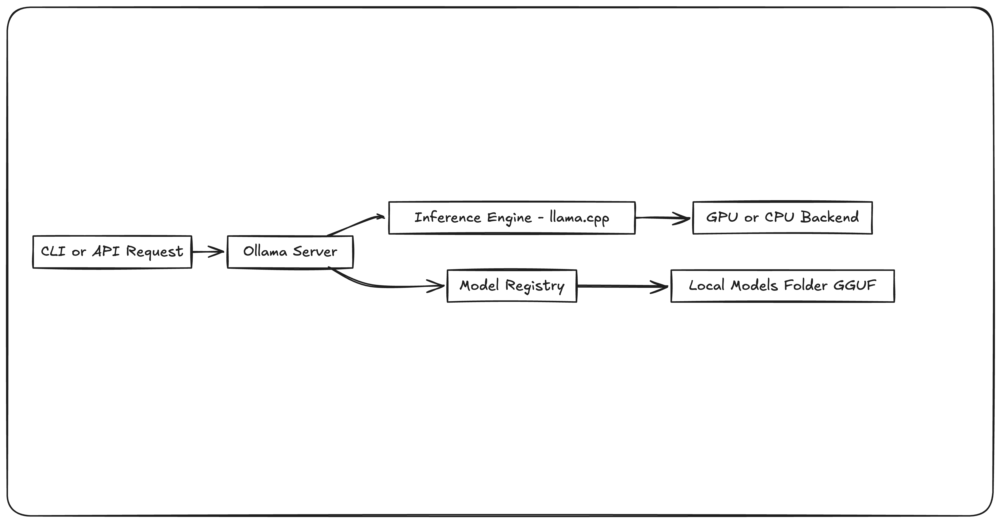

#### Key Components

| Component | Description |
|----------|-------------|
| **Ollama Server** | Background daemon that handles requests (runs on port 11434) |
| **llama.cpp** | Core inference engine – highly optimized C++ implementation |
| **Model Registry** | Downloads and caches models from `ollama.com/library` |
| **GGUF Format** | Quantized model format (4-bit, 8-bit) for efficient inference |
| **Hardware Backend** | Auto-detects GPU (CUDA / Metal) or falls back to CPU |

---

#### How It Works

1. **Model Pull**  
   Downloads GGUF quantized weights from the Ollama registry

2. **Model Load**  
   Loads the model into memory (GPU VRAM or system RAM)

3. **Inference**  
   Uses `llama.cpp` for token generation

4. **Streaming**  
   Returns tokens as they’re generated


## These commands are only for local machine

In [ ]:
#  Linux
!curl -fsSL https://ollama.com/install.sh | sh

# Windows: Download from https://ollama.com/download

# Verify installation
!ollama --version

>>> Installing ollama to /usr/local
>>> Downloading Linux amd64 bundle
######################################################################## 100.0%
>>> Creating ollama user...
>>> Adding ollama user to video group...
>>> Adding current user to ollama group...
>>> Creating ollama systemd service...
>>> The Ollama API is now available at 127.0.0.1:11434.
>>> Install complete. Run "ollama" from the command line.


### Essential Commands

In [ ]:
# Start Ollama server (usually auto-starts)
!ollama serve

Couldn't find '/root/.ollama/id_ed25519'. Generating new private key.
Your new public key is: 

ssh-ed25519 AAAAC3NzaC1lZDI1NTE5AAAAIMvLO+EdYX2kZzC+tE0pMVnmiNwar3sLje7jBpiVY3Hk

time=2025-12-17T08:11:29.092Z level=INFO source=routes.go:1554 msg="server config" env="map[CUDA_VISIBLE_DEVICES: GGML_VK_VISIBLE_DEVICES: GPU_DEVICE_ORDINAL: HIP_VISIBLE_DEVICES: HSA_OVERRIDE_GFX_VERSION: HTTPS_PROXY: HTTP_PROXY: NO_PROXY: OLLAMA_CONTEXT_LENGTH:4096 OLLAMA_DEBUG:INFO OLLAMA_FLASH_ATTENTION:false OLLAMA_GPU_OVERHEAD:0 OLLAMA_HOST:http://127.0.0.1:11434 OLLAMA_KEEP_ALIVE:5m0s OLLAMA_KV_CACHE_TYPE: OLLAMA_LLM_LIBRARY: OLLAMA_LOAD_TIMEOUT:5m0s OLLAMA_MAX_LOADED_MODELS:0 OLLAMA_MAX_QUEUE:512 OLLAMA_MODELS:/root/.ollama/models OLLAMA_MULTIUSER_CACHE:false OLLAMA_NEW_ENGINE:false OLLAMA_NOHISTORY:false OLLAMA_NOPRUNE:false OLLAMA_NUM_PARALLEL:1 OLLAMA_ORIGINS:[http://localhost https://localhost http://localhost:* https://localhost:* http://127.0.0.1 https://127.0.0.1 http://127.0.0.1:* https://127.0.

```

# List available models
!ollama list

# Pull a model
!ollama pull llama3.2

# Run interactive chat
ollama run llama3.2

# Run with a prompt
ollama run llama3.2 "What is Python?"

# Show model info
ollama show llama3.2

# Remove a model
ollama rm llama3.2

# Copy/create model variant
ollama cp llama3.2 my-llama```

Ollama Demo:Local Machine[Try on your own machine]